> # **Práctica 3: Clustering** 

Autores: Alejandro Barreiro Morante y Adrián Alcalá Gutiérrez

# **Inicializar datos y cargar librerias**

In [1]:
!git clone https://github.com/alejandro-bmorante-alumnos-upm-es/clustering.git

!pip install pyldavis==3.2.1
!pip install --upgrade gensim
!pip install nevergrad
!python3 -m spaCy download en

import zipfile
zip_ref = zipfile.ZipFile('/content/clustering/OkCupid.zip', 'r') 
zip_ref.extractall('/content') 

fatal: destination path 'clustering' already exists and is not an empty directory.
/usr/bin/python3: No module named spaCy


In [2]:
import pandas as pd
df = pd.read_csv("/content/okcupid_profiles.csv")


In [3]:
#########
#IMPORTS#
#########

#Utils
import numpy as np
import pandas as pd
import re
from pprint import pprint
import dill as pickle
from google.colab import drive
import sklearn
from sklearn import metrics
import sklearn.compose
import datetime

import pydotplus#borrar
from sklearn.impute import SimpleImputer #borrar

#NO WARNINGS
import warnings
warnings.filterwarnings("ignore")

# Visualization tools
import pyLDAvis
import pyLDAvis.sklearn
import pyLDAvis.gensim
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import seaborn as sns
from seaborn import pairplot
from matplotlib import pyplot as plt

#TOOLS FOR PREPROCESSING ESSAYS FIELDS
  #sklearn
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

  #Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from gensim import models
  #(para mostrar % de ejecucion)
  #tqdm derives from the Arabic word taqaddum (تقدّم) which can mean “progress,” and is an abbreviation for “I love you so much” in Spanish (te quiero demasiado). 
  #Demasiado bonito como para no ponerlo
import tqdm 
  # spaCy for Lemmatization
import spacy
nlp = spacy.load('en', disable=['parser', 'ner'])
  #nltk for stopwords
import nltk; nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')


#Optimizar Hiperparametros
from sklearn.model_selection import RandomizedSearchCV
import nevergrad as ng
from sklearn.model_selection import train_test_split


######### CLUSTERING Y REDUCCION DE DIMENSIONES##########

from sklearn.cluster import OPTICS, cluster_optics_dbscan
from sklearn.cluster import DBSCAN
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
from sklearn.decomposition import TruncatedSVD 
from sklearn.neighbors import kneighbors_graph
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import SpectralClustering

/usr/local/lib/python3.7/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Iterable
/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping
/usr/local/lib/python3.7/dist-packages/plotly/express/_doc.py:503: DeprecationWarning:

inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()

/usr/local/lib/python3.7/dist-packages/plotly/express/_doc.py:503: DeprecationWarning:

inspect.getargspec() is deprecated since Python 3.0, use inspect.signature() or inspect.getfullargspec()

/usr/local/lib/python3.7/dist-packages/plotly/express/_doc.py:503: DeprecationWarning:



[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!




>#  **Analisis de los datos**



In [ ]:
duplicate=df.duplicated()
print(duplicate.sum())

0


In [ ]:
print(df.describe())

                age        height          income
count  59946.000000  59943.000000    59946.000000
mean      32.340290     68.295281    20033.222534
std        9.452779      3.994803    97346.192104
min       18.000000      1.000000       -1.000000
25%       26.000000     66.000000       -1.000000
50%       30.000000     68.000000       -1.000000
75%       37.000000     71.000000       -1.000000
max      110.000000     95.000000  1000000.000000


In [ ]:
#Cantidad de nullos por fila
pd.DataFrame(df.isnull().sum(axis=1),columns=["num"]).sort_values("num",ascending=False)

,num
7842,22
8469,22
50019,22
8919,22
2512,22
...,...
14317,0
48578,0
48572,0
14359,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59946 entries, 0 to 59945
Data columns (total 31 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          59946 non-null  int64  
 1   status       59946 non-null  object 
 2   sex          59946 non-null  object 
 3   orientation  59946 non-null  object 
 4   body_type    54650 non-null  object 
 5   diet         35551 non-null  object 
 6   drinks       56961 non-null  object 
 7   drugs        45866 non-null  object 
 8   education    53318 non-null  object 
 9   ethnicity    54266 non-null  object 
 10  height       59943 non-null  float64
 11  income       59946 non-null  int64  
 12  job          51748 non-null  object 
 13  last_online  59946 non-null  object 
 14  location     59946 non-null  object 
 15  offspring    24385 non-null  object 
 16  pets         40025 non-null  object 
 17  religion     39720 non-null  object 
 18  sign         48890 non-null  object 
 19  smok

In [ ]:
print(df.nunique())

age               54
status             5
sex                2
orientation        3
body_type         12
diet              18
drinks             6
drugs              3
education         32
ethnicity        217
height            60
income            13
job               21
last_online    30123
location         199
offspring         15
pets              15
religion          45
sign              48
smokes             5
speaks          7647
essay0         54347
essay1         51516
essay2         48625
essay3         43520
essay4         49257
essay5         48961
essay6         43583
essay7         45548
essay8         39323
essay9         45440
dtype: int64


Planteamos reducir practicamente todos los campos.

In [ ]:
categoricalCols=[col for col in df.columns if df[col].dtypes=='O']
#remove essay ones
for col in categoricalCols[0:18]:
  print(df[col].value_counts())
  print("---------------------------")

single            55697
seeing someone     2064
available          1865
married             310
unknown              10
Name: status, dtype: int64
---------------------------
m    35829
f    24117
Name: sex, dtype: int64
---------------------------
straight    51606
gay          5573
bisexual     2767
Name: orientation, dtype: int64
---------------------------
average           14652
fit               12711
athletic          11819
thin               4711
curvy              3924
a little extra     2629
skinny             1777
full figured       1009
overweight          444
jacked              421
used up             355
rather not say      198
Name: body_type, dtype: int64
---------------------------
mostly anything        16585
anything                6183
strictly anything       5113
mostly vegetarian       3444
mostly other            1007
strictly vegetarian      875
vegetarian               667
strictly other           452
mostly vegan             338
other                    331
s

In [ ]:
pd.DataFrame(df["income"].value_counts())

,income
-1,48442
20000,2952
100000,1621
80000,1111
30000,1048
40000,1005
50000,975
60000,736
70000,707
150000,631


In [ ]:
pd.DataFrame(df["last_online"].value_counts())

,last_online
2012-06-29-22-56,24
2012-06-30-22-09,23
2012-06-30-22-56,23
2012-06-30-21-51,23
2012-06-30-23-27,23
...,...
2012-04-05-21-20,1
2012-03-10-09-15,1
2011-10-02-16-30,1
2012-06-25-19-53,1


>#  Tratar Essays


#### Preprocessing

In [4]:
for essay in df.columns[21:]:
  df[essay]= df[essay].fillna(' ')

essays=df[df.columns[21:]]
essays["essays"]=""
for essayX in essays.columns:
  essays["essays"]=essays.apply( lambda row: row["essays"]+ " " +row[essayX],axis=1)

In [ ]:
############### MODEL PREPROCESSING #################


#eliminando items innecesarios como la puntuación
def sent_to_words(essays):
    for essay in essays:
        yield(gensim.utils.simple_preprocess(str(essay), deacc=True))

# Definimos funciones para eliminar stopwords, bigrams, trigrams and lemmatization
def remove_stopwords(texts):
    return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    texts_out = []
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    return texts_out
def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

essaysPreprocessed = list(sent_to_words(essays["essays"]))

#   bigram y trigram modelos
bigram = gensim.models.Phrases(essaysPreprocessed, min_count=5, threshold=100)
trigram = gensim.models.Phrases(bigram[essaysPreprocessed], threshold=100)  

#Acelerar el procesado de bigramas y trigramas
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

essaysNoStopwords = remove_stopwords(essaysPreprocessed)

essaysTrigrams = make_trigrams(essaysNoStopwords)


essaysLemmatized = lemmatization(essaysTrigrams, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])


### Gensim

El LDA de Gensim no mejora al utilizar tfidf.

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(essaysLemmatized)

# Create Corpus
texts = essaysLemmatized

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1])

[[(0, 4), (1, 2), (2, 2), (3, 2), (4, 2), (5, 2), (6, 2), (7, 2), (8, 6), (9, 2), (10, 2), (11, 2), (12, 2), (13, 2), (14, 2), (15, 2), (16, 2), (17, 4), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (23, 2), (24, 2), (25, 2), (26, 2), (27, 2), (28, 2), (29, 2), (30, 2), (31, 4), (32, 2), (33, 2), (34, 4), (35, 2), (36, 4), (37, 4), (38, 4), (39, 2), (40, 2), (41, 6), (42, 2), (43, 2), (44, 6), (45, 2), (46, 4), (47, 2), (48, 4), (49, 2), (50, 2), (51, 2), (52, 2), (53, 2), (54, 2), (55, 2), (56, 2), (57, 2), (58, 2), (59, 2), (60, 4), (61, 2), (62, 4), (63, 4), (64, 2), (65, 2), (66, 4), (67, 2), (68, 2), (69, 4), (70, 8), (71, 12), (72, 2), (73, 4), (74, 2), (75, 2), (76, 2), (77, 2), (78, 2), (79, 2), (80, 2), (81, 2), (82, 2), (83, 2), (84, 2), (85, 2), (86, 2), (87, 2), (88, 2), (89, 2), (90, 4), (91, 2), (92, 6), (93, 2), (94, 4), (95, 2), (96, 2), (97, 2), (98, 2), (99, 2), (100, 8), (101, 2), (102, 2), (103, 4), (104, 2), (105, 4), (106, 2), (107, 2), (108, 2), (109, 2), (110, 2

In [ ]:
def imp(x):
  for idx, topic in x:
    print('Topic: {} \nWords: {}'.format(idx, topic))
    
import shutil
def sacarHtml(lda_model, corpus, id2word, name):
  pyLDAvis.enable_notebook()
  visualization = pyLDAvis.gensim.prepare(lda_model, corpus, id2word)
  visualization
  # Export the visualization as a html file.
  namehtml=name+".html"
  pyLDAvis.save_html(visualization, namehtml)
  shutil.copy("/content/"+namehtml,"drive/My Drive/Colab Notebooks/"+namehtml)

##### Optimizacion Hiperparametros

In [ ]:
########### OPTIMIZACION DE HIPERPARAMETROS DE GENSIM ########################

grid = {}

model_results = {
                 'Topics': [],
                 'Coherence': [],
                 'Perplexity':[],
                 "Alpha":[],
                 "Passes":[]
                }
maxPerp=0
maxCohe=0
if 1 == 1:
  pbar = tqdm.tqdm(total=540)
    for p in [10,20,30]:
        for a in ["symmetric","asymmetric"]:
          for numTopics in range(7,15,1):#topic range
                lda_model = gensim.models.LdaMulticore(corpus=corpus, id2word=id2word, num_topics=numTopics, 
                                                   random_state=1337,alpha=a,passes=p, workers=3,chunksize=60000)
                
                cv=CoherenceModel(model=lda_model, texts=essaysLemmatized, dictionary=id2word, coherence='c_v', corpus=c).get_coherence()
                px=np.exp(-1. * lda_model.log_perplexity(c))
                print()
                print("Topics::",numTopics,p,a)
                print("Coherence::",cv)
                print("Perplex::",px)
                imp(lda_model.print_topics(-1))
                if px>maxPerp:
                  px=maxPerp
                  bestPModel=lda_model
                if cv>maxCohe:
                  cv=maxCohe
                  bestCModel=lda_model
              # Save the model results
                model_results['Topics'].append(numTopics)
                model_results['Coherence'].append(cv)
                model_results['Perplexity'].append(px)
                model_results['Alpha'].append(a)
                model_results['Passes'].append(p)

                sacarHtml(lda_model,c,id2word,"T::"+str(numTopics)+"A::"+str(a)+"P::"+str(p))
                pbar.update(1)
  pd.DataFrame(model_results).to_csv('lda_tuning_results.csv', index=False)
  pbar.close()

In [ ]:
bestPModel.save('bestPModel.model')
bestCModel.save('bestCModel.model')
from google.colab import drive
drive.mount('drive')
!cp bestPModel.model "drive/My Drive/Colab Notebooks/bestPModel.model"
!cp bestCModel.model "drive/My Drive/Colab Notebooks/besCPModel.model"

In [ ]:
datos = {'Topics': [],'Coherence': []}
for i in model_results["Topics"]:
    datos['Topics'].append(i)
for i in model_results["Coherence"]:
    datos['Coherence'].append(i)
         
sns.relplot(x="Topics", y="Coherence", data=datos, kind="line");

###### Nevergrad

In [ ]:
def GensimOPti(nTopicsParam, corpus=corpus,id2word=id2word, essaysLemmatized=essaysLemmatized):
    print("N Topics::", nTopicsParam)
    lda_model = gensim.models.LdaMulticore(corpus=corpus, id2word=id2word, num_topics=nTopicsParam, 
                                           random_state=1337,chunksize=60000, passes=10, workers=3)
    coher=CoherenceModel(model=lda_model, texts=essaysLemmatized, dictionary=id2word, coherence='c_v').get_coherence()
    error=[1-coher] #Perpe?
    print("Cohere", coher)
    return error

nTopicsParam=ng.p.TransitionChoice(range(8,17,1))
params=ng.p.Instrumentation(nTopicsParam)
optimizer=ng.optimizers.NGOpt(parametrization=params, budget=10000)
best=optimizer.minimize(GensimOPti, batch_mode=False)

```
# RESULTADOS NEVERGRAD
N Topics:: 11
Cohere 0.35192084276644703
N Topics:: 8
Cohere 0.3312087103823508
N Topics:: 9
Cohere 0.3476603912177872
N Topics:: 8
Cohere 0.3319542713909409
N Topics:: 17
Cohere 0.3660496385540531
N Topics:: 23
Cohere 0.3727321177835519
N Topics:: 30
Cohere 0.38875021611852234
N Topics:: 36
Cohere 0.38165843701964336
N Topics:: 30
Cohere 0.38332847374342316
'''
```

##### Entrenamiento

In [ ]:
import logging 
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

In [ ]:
numTopics=10
a="symmetric"
p=10
lda_model = gensim.models.LdaMulticore(corpus=corpus, id2word=id2word, num_topics=numTopics, 
                                                   random_state=1337,alpha=a,passes=p, workers=3,chunksize=60000)
sacarHtml(lda_model,corpus,id2word,"T::"+str(numTopics)+"A::"+str(a)+"P::"+str(p))

##### Clasificacion de los documentos en funcion de los topicos

In [ ]:
#Elegir modelo y guardarlo
lda_model.save('lda.model')
!cp lda_model.model "drive/My Drive/Colab Notebooks/lda_model15.model"

# CARGA model =  models.LdaModel.load('lda.model')

In [ ]:
#### Aplicar Gensin para clasificar ####
#### EXTRAER LOS TOP 3 TOPICS POR DOCUMENTO ###

train_vecs = []
top3_vecs=[]
for i in range(len(essays["essays"])):
    top_topics =lda_model.get_document_topics(corpus[i], minimum_probability=0.0)
    topic_vec = [top_topics[i][1] for i in range(numTopics)]
    train_vecs.append(topic_vec)
    top=np.argsort(topic_vec)[::-1][:3]
    top3_vecs.append(top)

Text(0, 0.5, 'Varianza explicada')

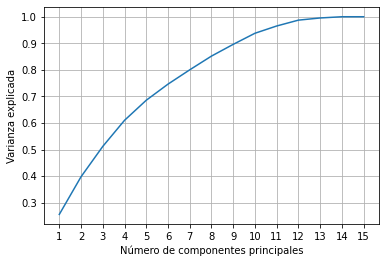

In [ ]:
pca = PCA(n_components=numTopics).fit(pd.DataFrame(train_vecs))

plt.figure(figsize=(10,6))

xx = np.arange(1, numTopics+1, step=1)
yy = np.cumsum(pca.explained_variance_ratio_)

plt.plot(xx, yy)
plt.xticks(xx)
plt.grid(True)


plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza explicada')

In [ ]:
for idx, topic in lda_model.print_topics(-1):
    print('Topic: {} \nWords: {}'.format(idx, topic))

Topic: 0 
Words: 0.014*"make" + 0.011*"good" + 0.010*"thing" + 0.009*"get" + 0.009*"people" + 0.009*"music" + 0.009*"really" + 0.009*"love" + 0.009*"think" + 0.008*"go"
Topic: 1 
Words: 0.008*"people" + 0.008*"make" + 0.007*"time" + 0.007*"thing" + 0.006*"go" + 0.006*"love" + 0.006*"also" + 0.005*"get" + 0.005*"know" + 0.005*"think"
Topic: 2 
Words: 0.014*"people" + 0.014*"time" + 0.012*"go" + 0.012*"thing" + 0.012*"new" + 0.011*"love" + 0.010*"good" + 0.010*"know" + 0.010*"also" + 0.009*"want"
Topic: 3 
Words: 0.018*"life" + 0.017*"love" + 0.011*"good" + 0.010*"time" + 0.009*"know" + 0.008*"be" + 0.007*"people" + 0.007*"live" + 0.006*"look" + 0.006*"make"
Topic: 4 
Words: 0.020*"love" + 0.012*"people" + 0.010*"good" + 0.009*"want" + 0.008*"thing" + 0.007*"read" + 0.007*"make" + 0.007*"also" + 0.007*"look" + 0.007*"life"
Topic: 5 
Words: 0.018*"food" + 0.017*"love" + 0.015*"movie" + 0.012*"music" + 0.011*"people" + 0.011*"friend" + 0.010*"go" + 0.010*"good" + 0.009*"show" + 0.009*"work

### SkLearn tiene peor rendimiento que Gensim

In [ ]:
processed=[]
for i in essaysLemmatized:
  string=""
  for x in i:
    string=string+x+" "
  processed.append(string)

In [ ]:
tf_vectorizer = CountVectorizer()
tf = tf_vectorizer.fit_transform(processed)

Los topicos extraidos tras la aplicacion de tfidf y su posterior analisis en pyLDAvis nos mostraban que no aportaba mejoras por lo q decidimos no usarlo


In [ ]:
vectorizer = TfidfVectorizer(**tf_vectorizer.get_params())
tf= vectorizer.fit_transform(processed)

In [ ]:
########### OPTIMIZACION DE HIPERPARAMETROS DE sklearn #####################

grid = {}
# Topics range

topics_range = range(7,12,1)
model_results = {
                 'Topics': [],
                 'Perplexity':[]
                }
maxPerp=0
if 1 == 1:
    pbar = tqdm.tqdm(total=540)
    # iterate through number of topics
    for k in topics_range:
      # iterate through alpha values
        learning_offset=50.
        lda = LatentDirichletAllocation(n_components=k,  
                                      learning_method='online',   
                                      random_state=1337,         
                                      learning_offset=learning_offset)
        doc_topic = lda.fit_transform(tf)
        px=lda.perplexity(tf)
        print("Topics::",k)
        print("Perplex::",px)
        pyLDAvis.enable_notebook()

        visualization=pyLDAvis.sklearn.prepare(lda, tf, tf_vectorizer)
        pyLDAvis.save_html(visualization, 'SK-'+str(k)+'.html')
        
        columna=[]
        for n in range(doc_topic.shape[0]):
            topic_most_pr = doc_topic[n].argmax()
            columna.append("doc: {} topic: {}\n".format(n,topic_most_pr))
        print()
      # Save the model results
        model_results['Topics'].append(k)
        model_results['Perplexity'].append(px)

        pbar.update(1)
    pd.DataFrame(model_results).to_csv('lda_tuning_results.csv', index=False)
    pbar.close()
print(model_results)

In [ ]:
######### OPTIMIZACION HIPERPARAMETOS #############

# Define Search Param
parameters = {'n_components': range(8,17,1)}

# Init the Model
lda = LatentDirichletAllocation()

# Init Grid Search Class
model = RandomizedSearchCV(lda, parameters, verbose=1, n_jobs=-1, cv=3)

# Do the Grid Search
model.fit(X)

In [ ]:
pd.DataFrame(model.cv_results_).sort_values('rank_test_score')

In [ ]:
######## FINAL TRAINING ########
learning_offset=50.
n_components=18
lda = LatentDirichletAllocation(n_components=n_components,  
                                      learning_method='online',   
                                      random_state=1337,         
                                      learning_offset=learning_offset,
                                      n_jobs = 3 ) 

lda.fit(tf) #https://stackoverflow.com/questions/45145368/python-scikit-learn-get-documents-per-topic-in-lda
doc_topic = lda.transform(tf)
columna=[]
for n in range(doc_topic.shape[0]):
    topic_most_pr = doc_topic[n].argmax()
    columna.append("doc: {} topic: {}\n".format(n,topic_most_pr))
#Guarda en topic_most_pr la mayor probabilidad de topico x documento

In [ ]:
print("Temas identificados:")
tf_feature_names = tf_vectorizer.get_feature_names_out()

def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([feature_names[i]
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()

print_top_words(lda, tf_feature_names, n_top_words)

In [ ]:
pyLDAvis.enable_notebook()

visualization=pyLDAvis.sklearn.prepare(lda, tf, tf_vectorizer)
pyLDAvis.save_html(visualization, 'LDA_sk15_45.html')


### Metricas utilizadas:

In [ ]:
#GENSIM  Compute Perplexity
print('\nPerplexity: ', np.exp(-1. * lda_model.log_perplexity(corpus)))  # a measure of how good the model is. Added a function to be able to compare it with SkLearn
# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=essaysLemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)

In [ ]:
#SKLEARN Compute Perplexity
print('\nPerplexity: ',lda.perplexity(tf))

###### Resultados

Full essay; No preprocessed SKLEARN, 15, 0.45:

Perplexity:  518.4973268556438

---
Full essay; Preprocessed SKLEARN, 15, 0.45: (con 14 va peor)


Perplexity:  449.4959396877772

---
Full essay; No preprocessed GENSIM, 15:


Perplexity:  1634.7562953540541

Coherence Score:  0.32482250118012335

---
Full essay;Bn preprocessed, 15

Perplexity:  16876.933302861853

Coherence Score:  0.37061875990424203


---
con essay 0

Perplexity:  -7.505756254198105

Coherence Score:  0.37331504539129606

In [ ]:
#Gensim
'''
  0%|          | 0/540 [00:00<?, ?it/s]

FUNCIONA BN:: 10 asymmetric 30

Topics:: 10 30 asymmetric
Coherence:: 0.31424903513424923
Perplex:: 1726.1370506375135
Corpus:: corpus
Topic: 0 
Words: 0.016*"make" + 0.011*"music" + 0.010*"good" + 0.010*"love" + 0.010*"get" + 0.009*"thing" + 0.009*"go" + 0.008*"people" + 0.008*"really" + 0.008*"know"
Topic: 1 
Words: 0.007*"make" + 0.006*"time" + 0.006*"people" + 0.005*"thing" + 0.005*"go" + 0.004*"get" + 0.004*"also" + 0.004*"know" + 0.004*"write" + 0.004*"year"
Topic: 2 
Words: 0.017*"people" + 0.017*"go" + 0.015*"time" + 0.014*"new" + 0.012*"thing" + 0.012*"get" + 0.011*"really" + 0.011*"want" + 0.010*"lot" + 0.010*"know"
Topic: 3 
Words: 0.022*"love" + 0.021*"life" + 0.010*"good" + 0.009*"time" + 0.009*"be" + 0.008*"know" + 0.007*"people" + 0.007*"live" + 0.007*"look" + 0.006*"make"
Topic: 4 
Words: 0.014*"love" + 0.013*"look" + 0.012*"people" + 0.011*"want" + 0.010*"woman" + 0.009*"good" + 0.008*"sex" + 0.008*"relationship" + 0.008*"know" + 0.007*"date"
Topic: 5 
Words: 0.018*"food" + 0.017*"movie" + 0.016*"music" + 0.015*"love" + 0.014*"friend" + 0.012*"show" + 0.011*"go" + 0.010*"work" + 0.010*"family" + 0.009*"book"
Topic: 6 
Words: 0.014*"thing" + 0.012*"really" + 0.011*"work" + 0.011*"time" + 0.011*"good" + 0.011*"go" + 0.011*"also" + 0.010*"movie" + 0.010*"get" + 0.009*"think"
Topic: 7 
Words: 0.028*"love" + 0.028*"friend" + 0.020*"good" + 0.019*"go" + 0.016*"work" + 0.015*"family" + 0.014*"time" + 0.013*"life" + 0.012*"enjoy" + 0.011*"people"
Topic: 8 
Words: 0.013*"thing" + 0.013*"people" + 0.010*"think" + 0.010*"make" + 0.009*"life" + 0.008*"good" + 0.007*"get" + 0.007*"love" + 0.007*"way" + 0.007*"find"
Topic: 9 
Words: 0.023*"love" + 0.022*"music" + 0.015*"enjoy" + 0.014*"friend" + 0.013*"good" + 0.011*"food" + 0.010*"movie" + 0.010*"book" + 0.010*"work" + 0.009*"life"

  0%|          | 1/540 [1:46:44<958:49:36, 6404.04s/it]

FUNCIONA BN:: 12 asymmetric 30

Topics:: 12 30 asymmetric
Coherence:: 0.31371573754210896
Perplex:: 1732.624847475271
Corpus:: corpus
Topic: 0 
Words: 0.016*"make" + 0.012*"good" + 0.010*"get" + 0.010*"thing" + 0.008*"think" + 0.008*"people" + 0.008*"really" + 0.008*"know" + 0.007*"go" + 0.007*"love"
Topic: 1 
Words: 0.007*"people" + 0.007*"make" + 0.007*"time" + 0.006*"thing" + 0.005*"know" + 0.005*"go" + 0.005*"also" + 0.005*"think" + 0.004*"would" + 0.004*"get"
Topic: 2 
Words: 0.023*"people" + 0.018*"new" + 0.016*"go" + 0.014*"time" + 0.014*"thing" + 0.013*"really" + 0.012*"meet" + 0.011*"know" + 0.011*"get" + 0.011*"lot"
Topic: 3 
Words: 0.031*"be" + 0.017*"know" + 0.015*"love" + 0.013*"good" + 0.013*"life" + 0.012*"go" + 0.011*"time" + 0.011*"lol" + 0.011*"music" + 0.010*"get"
Topic: 4 
Words: 0.015*"love" + 0.011*"look" + 0.010*"people" + 0.010*"want" + 0.009*"read" + 0.009*"good" + 0.009*"woman" + 0.009*"sex" + 0.008*"book" + 0.007*"also"
Topic: 5 
Words: 0.019*"food" + 0.015*"love" + 0.014*"friend" + 0.013*"movie" + 0.012*"music" + 0.012*"travel" + 0.011*"new" + 0.010*"go" + 0.010*"show" + 0.010*"work"
Topic: 6 
Words: 0.015*"thing" + 0.014*"work" + 0.012*"time" + 0.012*"good" + 0.011*"really" + 0.011*"get" + 0.011*"go" + 0.010*"think" + 0.009*"also" + 0.008*"lot"
Topic: 7 
Words: 0.032*"love" + 0.032*"friend" + 0.020*"good" + 0.019*"go" + 0.017*"family" + 0.016*"work" + 0.014*"time" + 0.014*"life" + 0.012*"movie" + 0.012*"enjoy"
Topic: 8 
Words: 0.013*"thing" + 0.011*"people" + 0.010*"think" + 0.010*"make" + 0.009*"want" + 0.009*"life" + 0.008*"good" + 0.008*"get" + 0.007*"love" + 0.007*"know"
Topic: 9 
Words: 0.026*"music" + 0.022*"love" + 0.017*"enjoy" + 0.015*"friend" + 0.013*"good" + 0.012*"food" + 0.011*"movie" + 0.011*"book" + 0.010*"live" + 0.010*"work"
Topic: 10 
Words: 0.019*"music" + 0.016*"movie" + 0.012*"make" + 0.012*"love" + 0.010*"book" + 0.010*"go" + 0.009*"show" + 0.009*"also" + 0.008*"thing" + 0.007*"really"
Topic: 11 
Words: 0.019*"love" + 0.017*"life" + 0.010*"people" + 0.008*"good" + 0.008*"make" + 0.007*"time" + 0.007*"thing" + 0.006*"relationship" + 0.006*"open" + 0.006*"feel"

  0%|          | 2/540 [3:40:30<994:12:56, 6652.74s/it]

FUNCIONA BN:: 14 asymmetric 30

Topics:: 14 30 asymmetric
Coherence:: 0.3128268159050621
Perplex:: 1746.080591613746
Corpus:: corpus
Topic: 0 
Words: 0.016*"make" + 0.012*"good" + 0.011*"get" + 0.009*"thing" + 0.009*"think" + 0.009*"know" + 0.008*"really" + 0.008*"go" + 0.008*"people" + 0.007*"time"
Topic: 1 
Words: 0.008*"people" + 0.007*"time" + 0.007*"make" + 0.006*"thing" + 0.005*"go" + 0.005*"know" + 0.005*"also" + 0.005*"would" + 0.005*"get" + 0.005*"think"
Topic: 2 
Words: 0.023*"people" + 0.015*"go" + 0.015*"thing" + 0.015*"new" + 0.015*"time" + 0.014*"really" + 0.012*"know" + 0.012*"lot" + 0.011*"also" + 0.011*"get"
Topic: 3 
Words: 0.033*"be" + 0.017*"know" + 0.017*"love" + 0.014*"good" + 0.014*"life" + 0.013*"go" + 0.013*"lol" + 0.012*"time" + 0.010*"get" + 0.010*"work"
Topic: 4 
Words: 0.016*"love" + 0.014*"look" + 0.012*"woman" + 0.011*"want" + 0.010*"people" + 0.010*"good" + 0.009*"sex" + 0.008*"date" + 0.008*"man" + 0.008*"guy"
Topic: 5 
Words: 0.021*"food" + 0.015*"love" + 0.015*"movie" + 0.014*"friend" + 0.014*"music" + 0.012*"show" + 0.011*"travel" + 0.011*"new" + 0.010*"family" + 0.010*"go"
Topic: 6 
Words: 0.016*"work" + 0.015*"thing" + 0.012*"time" + 0.011*"get" + 0.011*"good" + 0.011*"go" + 0.011*"really" + 0.009*"think" + 0.009*"also" + 0.008*"year"
Topic: 7 
Words: 0.033*"love" + 0.033*"friend" + 0.021*"good" + 0.020*"go" + 0.017*"family" + 0.016*"work" + 0.014*"time" + 0.014*"life" + 0.013*"make" + 0.012*"enjoy"
Topic: 8 
Words: 0.011*"thing" + 0.010*"think" + 0.009*"life" + 0.009*"people" + 0.009*"want" + 0.008*"make" + 0.008*"get" + 0.008*"good" + 0.008*"know" + 0.007*"love"
Topic: 9 
Words: 0.022*"love" + 0.022*"music" + 0.018*"enjoy" + 0.015*"friend" + 0.013*"good" + 0.012*"movie" + 0.012*"food" + 0.011*"book" + 0.010*"live" + 0.010*"life"
Topic: 10 
Words: 0.019*"movie" + 0.015*"music" + 0.012*"love" + 0.012*"make" + 0.011*"go" + 0.011*"book" + 0.010*"also" + 0.010*"show" + 0.009*"really" + 0.008*"watch"
Topic: 11 
Words: 0.020*"love" + 0.017*"life" + 0.010*"people" + 0.008*"good" + 0.008*"make" + 0.007*"time" + 0.007*"thing" + 0.006*"feel" + 0.006*"open" + 0.006*"live"
Topic: 12 
Words: 0.007*"thing" + 0.007*"art" + 0.007*"make" + 0.006*"music" + 0.006*"write" + 0.005*"book" + 0.005*"stuff" + 0.005*"food" + 0.005*"love" + 0.005*"good"
Topic: 13 
Words: 0.029*"music" + 0.014*"thing" + 0.014*"make" + 0.013*"people" + 0.012*"play" + 0.011*"love" + 0.011*"good" + 0.010*"work" + 0.009*"time" + 0.009*"art"

  1%|          | 3/540 [5:38:07<1019:53:05, 6837.22s/it]

FUNCIONA BN:: 16 asymmetric 30

Topics:: 16 30 asymmetric
Coherence:: 0.31142269599622807
Perplex:: 1759.6478223960166
Corpus:: corpus
Topic: 0 
Words: 0.017*"make" + 0.013*"good" + 0.011*"get" + 0.010*"thing" + 0.009*"really" + 0.008*"know" + 0.008*"think" + 0.008*"people" + 0.008*"go" + 0.007*"love"
Topic: 1 
Words: 0.008*"time" + 0.008*"make" + 0.007*"people" + 0.007*"thing" + 0.005*"would" + 0.005*"know" + 0.005*"get" + 0.005*"go" + 0.004*"may" + 0.004*"year"
Topic: 2 
Words: 0.023*"people" + 0.017*"new" + 0.015*"go" + 0.015*"thing" + 0.015*"time" + 0.013*"really" + 0.012*"meet" + 0.012*"get" + 0.012*"know" + 0.012*"want"
Topic: 3 
Words: 0.031*"be" + 0.018*"know" + 0.017*"love" + 0.015*"good" + 0.015*"life" + 0.013*"go" + 0.012*"time" + 0.012*"lol" + 0.011*"get" + 0.011*"want"
Topic: 4 
Words: 0.019*"love" + 0.012*"word" + 0.010*"book" + 0.010*"language" + 0.010*"good" + 0.009*"read" + 0.009*"people" + 0.007*"work" + 0.007*"food" + 0.006*"thing"
Topic: 5 
Words: 0.021*"food" + 0.015*"love" + 0.015*"movie" + 0.014*"friend" + 0.014*"music" + 0.012*"show" + 0.011*"new" + 0.011*"travel" + 0.011*"family" + 0.010*"go"
Topic: 6 
Words: 0.017*"work" + 0.015*"thing" + 0.012*"time" + 0.012*"get" + 0.012*"really" + 0.012*"go" + 0.012*"good" + 0.009*"think" + 0.009*"much" + 0.009*"also"
Topic: 7 
Words: 0.034*"love" + 0.033*"friend" + 0.021*"good" + 0.020*"go" + 0.017*"family" + 0.016*"work" + 0.014*"time" + 0.014*"life" + 0.013*"make" + 0.012*"people"
Topic: 8 
Words: 0.010*"thing" + 0.009*"make" + 0.009*"get" + 0.009*"want" + 0.008*"life" + 0.008*"love" + 0.008*"good" + 0.007*"world" + 0.007*"friend" + 0.007*"people"
Topic: 9 
Words: 0.022*"music" + 0.022*"love" + 0.019*"enjoy" + 0.015*"friend" + 0.013*"good" + 0.013*"movie" + 0.012*"food" + 0.011*"book" + 0.010*"live" + 0.010*"life"
Topic: 10 
Words: 0.020*"movie" + 0.016*"music" + 0.012*"love" + 0.012*"make" + 0.011*"go" + 0.011*"book" + 0.010*"show" + 0.009*"also" + 0.009*"watch" + 0.008*"really"
Topic: 11 
Words: 0.021*"love" + 0.018*"life" + 0.010*"people" + 0.009*"good" + 0.008*"make" + 0.007*"thing" + 0.007*"time" + 0.006*"feel" + 0.006*"relationship" + 0.006*"open"
Topic: 12 
Words: 0.008*"thing" + 0.007*"stuff" + 0.006*"make" + 0.006*"food" + 0.006*"book" + 0.006*"write" + 0.005*"music" + 0.005*"coffee" + 0.005*"good" + 0.005*"eat"
Topic: 13 
Words: 0.033*"music" + 0.015*"thing" + 0.014*"people" + 0.014*"make" + 0.012*"good" + 0.012*"play" + 0.012*"love" + 0.011*"work" + 0.010*"time" + 0.008*"art"
Topic: 14 
Words: 0.023*"sex" + 0.016*"want" + 0.014*"look" + 0.014*"woman" + 0.013*"date" + 0.011*"man" + 0.009*"love" + 0.008*"work" + 0.008*"guy" + 0.008*"relationship"
Topic: 15 
Words: 0.012*"people" + 0.012*"think" + 0.009*"say" + 0.009*"also" + 0.009*"write" + 0.008*"know" + 0.007*"thing" + 0.007*"go" + 0.006*"read" + 0.006*"would"

  1%|          | 4/540 [7:37:29<1037:02:36, 6965.22s/it]

FUNCIONA BN:: 10 asymmetric 30
-----
  0%|          | 0/540 [00:00<?, ?it/s]

FUNCIONA BN:: 10 asymmetric 30

Topics:: 10 30 asymmetric
Coherence:: 0.31424903513424923
Perplex:: 1726.1370506375135
Corpus:: corpus
Topic: 0 
Words: 0.016*"make" + 0.011*"music" + 0.010*"good" + 0.010*"love" + 0.010*"get" + 0.009*"thing" + 0.009*"go" + 0.008*"people" + 0.008*"really" + 0.008*"know"
Topic: 1 
Words: 0.007*"make" + 0.006*"time" + 0.006*"people" + 0.005*"thing" + 0.005*"go" + 0.004*"get" + 0.004*"also" + 0.004*"know" + 0.004*"write" + 0.004*"year"
Topic: 2 
Words: 0.017*"people" + 0.017*"go" + 0.015*"time" + 0.014*"new" + 0.012*"thing" + 0.012*"get" + 0.011*"really" + 0.011*"want" + 0.010*"lot" + 0.010*"know"
Topic: 3 
Words: 0.022*"love" + 0.021*"life" + 0.010*"good" + 0.009*"time" + 0.009*"be" + 0.008*"know" + 0.007*"people" + 0.007*"live" + 0.007*"look" + 0.006*"make"
Topic: 4 
Words: 0.014*"love" + 0.013*"look" + 0.012*"people" + 0.011*"want" + 0.010*"woman" + 0.009*"good" + 0.008*"sex" + 0.008*"relationship" + 0.008*"know" + 0.007*"date"
Topic: 5 
Words: 0.018*"food" + 0.017*"movie" + 0.016*"music" + 0.015*"love" + 0.014*"friend" + 0.012*"show" + 0.011*"go" + 0.010*"work" + 0.010*"family" + 0.009*"book"
Topic: 6 
Words: 0.014*"thing" + 0.012*"really" + 0.011*"work" + 0.011*"time" + 0.011*"good" + 0.011*"go" + 0.011*"also" + 0.010*"movie" + 0.010*"get" + 0.009*"think"
Topic: 7 
Words: 0.028*"love" + 0.028*"friend" + 0.020*"good" + 0.019*"go" + 0.016*"work" + 0.015*"family" + 0.014*"time" + 0.013*"life" + 0.012*"enjoy" + 0.011*"people"
Topic: 8 
Words: 0.013*"thing" + 0.013*"people" + 0.010*"think" + 0.010*"make" + 0.009*"life" + 0.008*"good" + 0.007*"get" + 0.007*"love" + 0.007*"way" + 0.007*"find"
Topic: 9 
Words: 0.023*"love" + 0.022*"music" + 0.015*"enjoy" + 0.014*"friend" + 0.013*"good" + 0.011*"food" + 0.010*"movie" + 0.010*"book" + 0.010*"work" + 0.009*"life"

  0%|          | 1/540 [1:46:44<958:49:36, 6404.04s/it]

FUNCIONA BN:: 12 asymmetric 30

Topics:: 12 30 asymmetric
Coherence:: 0.31371573754210896
Perplex:: 1732.624847475271
Corpus:: corpus
Topic: 0 
Words: 0.016*"make" + 0.012*"good" + 0.010*"get" + 0.010*"thing" + 0.008*"think" + 0.008*"people" + 0.008*"really" + 0.008*"know" + 0.007*"go" + 0.007*"love"
Topic: 1 
Words: 0.007*"people" + 0.007*"make" + 0.007*"time" + 0.006*"thing" + 0.005*"know" + 0.005*"go" + 0.005*"also" + 0.005*"think" + 0.004*"would" + 0.004*"get"
Topic: 2 
Words: 0.023*"people" + 0.018*"new" + 0.016*"go" + 0.014*"time" + 0.014*"thing" + 0.013*"really" + 0.012*"meet" + 0.011*"know" + 0.011*"get" + 0.011*"lot"
Topic: 3 
Words: 0.031*"be" + 0.017*"know" + 0.015*"love" + 0.013*"good" + 0.013*"life" + 0.012*"go" + 0.011*"time" + 0.011*"lol" + 0.011*"music" + 0.010*"get"
Topic: 4 
Words: 0.015*"love" + 0.011*"look" + 0.010*"people" + 0.010*"want" + 0.009*"read" + 0.009*"good" + 0.009*"woman" + 0.009*"sex" + 0.008*"book" + 0.007*"also"
Topic: 5 
Words: 0.019*"food" + 0.015*"love" + 0.014*"friend" + 0.013*"movie" + 0.012*"music" + 0.012*"travel" + 0.011*"new" + 0.010*"go" + 0.010*"show" + 0.010*"work"
Topic: 6 
Words: 0.015*"thing" + 0.014*"work" + 0.012*"time" + 0.012*"good" + 0.011*"really" + 0.011*"get" + 0.011*"go" + 0.010*"think" + 0.009*"also" + 0.008*"lot"
Topic: 7 
Words: 0.032*"love" + 0.032*"friend" + 0.020*"good" + 0.019*"go" + 0.017*"family" + 0.016*"work" + 0.014*"time" + 0.014*"life" + 0.012*"movie" + 0.012*"enjoy"
Topic: 8 
Words: 0.013*"thing" + 0.011*"people" + 0.010*"think" + 0.010*"make" + 0.009*"want" + 0.009*"life" + 0.008*"good" + 0.008*"get" + 0.007*"love" + 0.007*"know"
Topic: 9 
Words: 0.026*"music" + 0.022*"love" + 0.017*"enjoy" + 0.015*"friend" + 0.013*"good" + 0.012*"food" + 0.011*"movie" + 0.011*"book" + 0.010*"live" + 0.010*"work"
Topic: 10 
Words: 0.019*"music" + 0.016*"movie" + 0.012*"make" + 0.012*"love" + 0.010*"book" + 0.010*"go" + 0.009*"show" + 0.009*"also" + 0.008*"thing" + 0.007*"really"
Topic: 11 
Words: 0.019*"love" + 0.017*"life" + 0.010*"people" + 0.008*"good" + 0.008*"make" + 0.007*"time" + 0.007*"thing" + 0.006*"relationship" + 0.006*"open" + 0.006*"feel"

  0%|          | 2/540 [3:40:30<994:12:56, 6652.74s/it]

FUNCIONA BN:: 14 asymmetric 30

Topics:: 14 30 asymmetric
Coherence:: 0.3128268159050621
Perplex:: 1746.080591613746
Corpus:: corpus
Topic: 0 
Words: 0.016*"make" + 0.012*"good" + 0.011*"get" + 0.009*"thing" + 0.009*"think" + 0.009*"know" + 0.008*"really" + 0.008*"go" + 0.008*"people" + 0.007*"time"
Topic: 1 
Words: 0.008*"people" + 0.007*"time" + 0.007*"make" + 0.006*"thing" + 0.005*"go" + 0.005*"know" + 0.005*"also" + 0.005*"would" + 0.005*"get" + 0.005*"think"
Topic: 2 
Words: 0.023*"people" + 0.015*"go" + 0.015*"thing" + 0.015*"new" + 0.015*"time" + 0.014*"really" + 0.012*"know" + 0.012*"lot" + 0.011*"also" + 0.011*"get"
Topic: 3 
Words: 0.033*"be" + 0.017*"know" + 0.017*"love" + 0.014*"good" + 0.014*"life" + 0.013*"go" + 0.013*"lol" + 0.012*"time" + 0.010*"get" + 0.010*"work"
Topic: 4 
Words: 0.016*"love" + 0.014*"look" + 0.012*"woman" + 0.011*"want" + 0.010*"people" + 0.010*"good" + 0.009*"sex" + 0.008*"date" + 0.008*"man" + 0.008*"guy"
Topic: 5 
Words: 0.021*"food" + 0.015*"love" + 0.015*"movie" + 0.014*"friend" + 0.014*"music" + 0.012*"show" + 0.011*"travel" + 0.011*"new" + 0.010*"family" + 0.010*"go"
Topic: 6 
Words: 0.016*"work" + 0.015*"thing" + 0.012*"time" + 0.011*"get" + 0.011*"good" + 0.011*"go" + 0.011*"really" + 0.009*"think" + 0.009*"also" + 0.008*"year"
Topic: 7 
Words: 0.033*"love" + 0.033*"friend" + 0.021*"good" + 0.020*"go" + 0.017*"family" + 0.016*"work" + 0.014*"time" + 0.014*"life" + 0.013*"make" + 0.012*"enjoy"
Topic: 8 
Words: 0.011*"thing" + 0.010*"think" + 0.009*"life" + 0.009*"people" + 0.009*"want" + 0.008*"make" + 0.008*"get" + 0.008*"good" + 0.008*"know" + 0.007*"love"
Topic: 9 
Words: 0.022*"love" + 0.022*"music" + 0.018*"enjoy" + 0.015*"friend" + 0.013*"good" + 0.012*"movie" + 0.012*"food" + 0.011*"book" + 0.010*"live" + 0.010*"life"
Topic: 10 
Words: 0.019*"movie" + 0.015*"music" + 0.012*"love" + 0.012*"make" + 0.011*"go" + 0.011*"book" + 0.010*"also" + 0.010*"show" + 0.009*"really" + 0.008*"watch"
Topic: 11 
Words: 0.020*"love" + 0.017*"life" + 0.010*"people" + 0.008*"good" + 0.008*"make" + 0.007*"time" + 0.007*"thing" + 0.006*"feel" + 0.006*"open" + 0.006*"live"
Topic: 12 
Words: 0.007*"thing" + 0.007*"art" + 0.007*"make" + 0.006*"music" + 0.006*"write" + 0.005*"book" + 0.005*"stuff" + 0.005*"food" + 0.005*"love" + 0.005*"good"
Topic: 13 
Words: 0.029*"music" + 0.014*"thing" + 0.014*"make" + 0.013*"people" + 0.012*"play" + 0.011*"love" + 0.011*"good" + 0.010*"work" + 0.009*"time" + 0.009*"art"

  1%|          | 3/540 [5:38:07<1019:53:05, 6837.22s/it]

FUNCIONA BN:: 16 asymmetric 30

Topics:: 16 30 asymmetric
Coherence:: 0.31142269599622807
Perplex:: 1759.6478223960166
Corpus:: corpus
Topic: 0 
Words: 0.017*"make" + 0.013*"good" + 0.011*"get" + 0.010*"thing" + 0.009*"really" + 0.008*"know" + 0.008*"think" + 0.008*"people" + 0.008*"go" + 0.007*"love"
Topic: 1 
Words: 0.008*"time" + 0.008*"make" + 0.007*"people" + 0.007*"thing" + 0.005*"would" + 0.005*"know" + 0.005*"get" + 0.005*"go" + 0.004*"may" + 0.004*"year"
Topic: 2 
Words: 0.023*"people" + 0.017*"new" + 0.015*"go" + 0.015*"thing" + 0.015*"time" + 0.013*"really" + 0.012*"meet" + 0.012*"get" + 0.012*"know" + 0.012*"want"
Topic: 3 
Words: 0.031*"be" + 0.018*"know" + 0.017*"love" + 0.015*"good" + 0.015*"life" + 0.013*"go" + 0.012*"time" + 0.012*"lol" + 0.011*"get" + 0.011*"want"
Topic: 4 
Words: 0.019*"love" + 0.012*"word" + 0.010*"book" + 0.010*"language" + 0.010*"good" + 0.009*"read" + 0.009*"people" + 0.007*"work" + 0.007*"food" + 0.006*"thing"
Topic: 5 
Words: 0.021*"food" + 0.015*"love" + 0.015*"movie" + 0.014*"friend" + 0.014*"music" + 0.012*"show" + 0.011*"new" + 0.011*"travel" + 0.011*"family" + 0.010*"go"
Topic: 6 
Words: 0.017*"work" + 0.015*"thing" + 0.012*"time" + 0.012*"get" + 0.012*"really" + 0.012*"go" + 0.012*"good" + 0.009*"think" + 0.009*"much" + 0.009*"also"
Topic: 7 
Words: 0.034*"love" + 0.033*"friend" + 0.021*"good" + 0.020*"go" + 0.017*"family" + 0.016*"work" + 0.014*"time" + 0.014*"life" + 0.013*"make" + 0.012*"people"
Topic: 8 
Words: 0.010*"thing" + 0.009*"make" + 0.009*"get" + 0.009*"want" + 0.008*"life" + 0.008*"love" + 0.008*"good" + 0.007*"world" + 0.007*"friend" + 0.007*"people"
Topic: 9 
Words: 0.022*"music" + 0.022*"love" + 0.019*"enjoy" + 0.015*"friend" + 0.013*"good" + 0.013*"movie" + 0.012*"food" + 0.011*"book" + 0.010*"live" + 0.010*"life"
Topic: 10 
Words: 0.020*"movie" + 0.016*"music" + 0.012*"love" + 0.012*"make" + 0.011*"go" + 0.011*"book" + 0.010*"show" + 0.009*"also" + 0.009*"watch" + 0.008*"really"
Topic: 11 
Words: 0.021*"love" + 0.018*"life" + 0.010*"people" + 0.009*"good" + 0.008*"make" + 0.007*"thing" + 0.007*"time" + 0.006*"feel" + 0.006*"relationship" + 0.006*"open"
Topic: 12 
Words: 0.008*"thing" + 0.007*"stuff" + 0.006*"make" + 0.006*"food" + 0.006*"book" + 0.006*"write" + 0.005*"music" + 0.005*"coffee" + 0.005*"good" + 0.005*"eat"
Topic: 13 
Words: 0.033*"music" + 0.015*"thing" + 0.014*"people" + 0.014*"make" + 0.012*"good" + 0.012*"play" + 0.012*"love" + 0.011*"work" + 0.010*"time" + 0.008*"art"
Topic: 14 
Words: 0.023*"sex" + 0.016*"want" + 0.014*"look" + 0.014*"woman" + 0.013*"date" + 0.011*"man" + 0.009*"love" + 0.008*"work" + 0.008*"guy" + 0.008*"relationship"
Topic: 15 
Words: 0.012*"people" + 0.012*"think" + 0.009*"say" + 0.009*"also" + 0.009*"write" + 0.008*"know" + 0.007*"thing" + 0.007*"go" + 0.006*"read" + 0.006*"would"

  1%|          | 4/540 [7:37:29<1037:02:36, 6965.22s/it]

FUNCIONA BN:: 10 asymmetric 30

Topics:: 10 30 asymmetric
Coherence:: 0.38482007707449634
Perplex:: 14533.689829216855
Corpus:: corpus
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"thing" + 0.002*"life" + 0.002*"go" + 0.002*"really" + 0.002*"want"
Topic: 1 
Words: 0.000*"whit" + 0.000*"checking" + 0.000*"paypa" + 0.000*"loyality" + 0.000*"quess" + 0.000*"liars_poker" + 0.000*"communications" + 0.000*"dolor" + 0.000*"nothing" + 0.000*"tortor"
Topic: 2 
Words: 0.000*"abt" + 0.000*"hmu" + 0.000*"verbal_sparre" + 0.000*"ghtr_rth" + 0.000*"laghe" + 0.000*"naturist" + 0.000*"rasheedlyon" + 0.000*"aventurous" + 0.000*"konow" + 0.000*"funloving"
Topic: 3 
Words: 0.000*"doctoring" + 0.000*"irasian" + 0.000*"mimde" + 0.000*"granddaughterl" + 0.000*"pwc" + 0.000*"whoever" + 0.000*"dutchmaster" + 0.000*"weareswell" + 0.000*"screwin" + 0.000*"scenary"
Topic: 4 
Words: 0.000*"appreaciate" + 0.000*"labile" + 0.000*"forensic_psychology" + 0.000*"nevernude" + 0.000*"excotic" + 0.000*"wrke" + 0.000*"bicurious" + 0.000*"gethire" + 0.000*"aaaaaaaah" + 0.000*"shiiiiiii"
Topic: 5 
Words: 0.000*"hypothetical_situation" + 0.000*"hobi" + 0.000*"acounte" + 0.000*"krav" + 0.000*"chilaxin" + 0.000*"toothpast" + 0.000*"eather" + 0.000*"cought" + 0.000*"sythesis" + 0.000*"diatnace"
Topic: 6 
Words: 0.000*"hiper" + 0.000*"ballmer" + 0.000*"metrically" + 0.000*"gluon" + 0.000*"academiy" + 0.000*"hadron" + 0.000*"ittttt" + 0.000*"love" + 0.000*"thing" + 0.000*"really"
Topic: 7 
Words: 0.000*"toplaye" + 0.000*"brodcaste" + 0.000*"beauties" + 0.000*"points" + 0.000*"desyfer" + 0.000*"oriantate" + 0.000*"holloween" + 0.000*"sice" + 0.000*"tatooing" + 0.000*"domanate"
Topic: 8 
Words: 0.000*"love" + 0.000*"also" + 0.000*"good" + 0.000*"life" + 0.000*"people" + 0.000*"think" + 0.000*"want" + 0.000*"say" + 0.000*"much" + 0.000*"thing"
Topic: 9 
Words: 0.000*"darondo" + 0.000*"smokeland" + 0.000*"everyhte" + 0.000*"funness" + 0.000*"loooooooooove" + 0.000*"majid" + 0.000*"chickenatarian" + 0.000*"enjoy" + 0.000*"life" + 0.000*"love"

  1%|          | 5/540 [9:03:05<937:06:03, 6305.73s/it] 

FUNCIONA BN:: 12 asymmetric 30

Topics:: 12 30 asymmetric
Coherence:: 0.3189260209495824
Perplex:: 16041.9368203274
Corpus:: corpus
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"thing" + 0.002*"life" + 0.002*"go" + 0.002*"really" + 0.002*"want"
Topic: 1 
Words: 0.000*"checking" + 0.000*"intreste" + 0.000*"poeple" + 0.000*"loyality" + 0.000*"paypa" + 0.000*"sportcenter" + 0.000*"physician_assistant" + 0.000*"bragger" + 0.000*"nisi" + 0.000*"billz"
Topic: 2 
Words: 0.000*"outgoin" + 0.000*"resently" + 0.000*"caity" + 0.000*"ustad" + 0.000*"hiphop" + 0.000*"painting_sculpte" + 0.000*"hypothetical_situation" + 0.000*"ogloss" + 0.000*"braininess" + 0.000*"trespassing"
Topic: 3 
Words: 0.000*"restriction" + 0.000*"doctoring" + 0.000*"ghtr_rth" + 0.000*"djaye" + 0.000*"barbara" + 0.000*"tushy" + 0.000*"amusment" + 0.000*"humboldt_county" + 0.000*"racing_sailboat" + 0.000*"skeletoe"
Topic: 4 
Words: 0.000*"maken" + 0.000*"someodd" + 0.000*"pictureless" + 0.000*"sendai" + 0.000*"pwc" + 0.000*"prepearre" + 0.000*"addapte" + 0.000*"pre_op_transsexual" + 0.000*"heebie_jeebie" + 0.000*"muralist"
Topic: 5 
Words: 0.000*"flushable" + 0.000*"modle" + 0.000*"daceing" + 0.000*"frendly" + 0.000*"zac" + 0.000*"milck" + 0.000*"appriciate" + 0.000*"palce" + 0.000*"responsable" + 0.000*"wrenchin"
Topic: 6 
Words: 0.000*"qwerty" + 0.000*"lavarla" + 0.000*"despue" + 0.000*"mokingjay" + 0.000*"cailfornication" + 0.000*"relationsip" + 0.000*"surgar" + 0.000*"snowboardig" + 0.000*"depicable" + 0.000*"sleave"
Topic: 7 
Words: 0.000*"feild" + 0.000*"kthank" + 0.000*"bcz" + 0.000*"possilbe" + 0.000*"accompolishe" + 0.000*"entourgage" + 0.000*"passiaonate" + 0.000*"uniqe" + 0.000*"bck" + 0.000*"defferent"
Topic: 8 
Words: 0.000*"thiis" + 0.000*"respecful" + 0.000*"specail" + 0.000*"angent" + 0.000*"relly" + 0.000*"funnyness" + 0.000*"jst" + 0.000*"futrue" + 0.000*"fiiction" + 0.000*"mybe"
Topic: 9 
Words: 0.000*"urself" + 0.000*"enythe" + 0.000*"viewegh" + 0.000*"mdna" + 0.000*"fabolouse" + 0.000*"scissorhan" + 0.000*"watter" + 0.000*"helmit" + 0.000*"eny" + 0.000*"suport"
Topic: 10 
Words: 0.000*"typicall" + 0.000*"guinuine" + 0.000*"accurantlly" + 0.000*"rootabaga" + 0.000*"conducting_interview" + 0.000*"digestion" + 0.000*"love" + 0.000*"enjoy" + 0.000*"also" + 0.000*"really"
Topic: 11 
Words: 0.000*"toplaye" + 0.000*"accompanied" + 0.000*"clicker" + 0.000*"trange" + 0.000*"cherchez" + 0.000*"pntrant" + 0.000*"aime" + 0.000*"esprit" + 0.000*"kubric" + 0.000*"donc"

  1%|          | 6/540 [10:31:36<885:10:48, 5967.51s/it]

FUNCIONA BN:: 14 asymmetric 30



'''

In [ ]:
#Coherence:: 0.3612267893870964-22
#Coherence:: 0.3303229125002805- 25

'''
 0%|          | 1/540 [44:40<401:22:47, 2680.83s/it]


Topics:: 26
Coherence:: 0.4099182800879263
Perplex:: 2540.210683842531


  0%|          | 2/540 [1:31:18<410:51:46, 2749.27s/it]


Topics:: 29
Coherence:: 0.5635833056795979
Perplex:: 2521.8567315276528


  1%|          | 3/540 [2:20:38<424:28:02, 2845.59s/it]


Topics:: 32
Coherence:: 0.5374676839690727
Perplex:: 2555.7177012335633


  1%|          | 4/540 [3:10:55<433:46:33, 2913.42s/it]


Topics:: 35
Coherence:: 0.501687073535338
Perplex:: 2577.74560383376


  1%|          | 5/540 [4:03:53<434:57:07, 2926.78s/it]


Topics:: 38
Coherence:: 0.5276457519054232
Perplex:: 2634.424406851623

'''
'''

  0%|          | 0/540 [1:07:22<?, ?it/s]

  0%|          | 1/540 [25:25<228:26:36, 1525.78s/it]
Topics:: 28
Coherence:: 0.5253160172928846
Perplex:: 2422.6017088003364
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"life" + 0.002*"thing" + 0.002*"go" + 0.002*"really" + 0.002*"family"
Topic: 1 
Words: 0.001*"vain" + 0.001*"traveller" + 0.001*"scout" + 0.001*"confusion" + 0.001*"checking" + 0.001*"washing_dishe" + 0.001*"franchise" + 0.001*"tuna" + 0.001*"super_trooper" + 0.001*"descendent"
Topic: 2 
Words: 0.001*"san_francisco_state" + 0.001*"raisin" + 0.001*"might" + 0.001*"babysitter" + 0.001*"bird_chronicle" + 0.001*"yearly" + 0.001*"kite_runner_thousand_splendid" + 0.001*"micro" + 0.001*"backbone" + 0.001*"tripping"
Topic: 3 
Words: 0.001*"dummy" + 0.001*"nickel" + 0.001*"headache" + 0.001*"fro" + 0.001*"punchline" + 0.001*"hump" + 0.001*"formally" + 0.001*"childcare" + 0.001*"understate" + 0.001*"downside"
Topic: 4 
Words: 0.001*"coldest_winter_ever" + 0.001*"kindre" + 0.001*"strategist" + 0.001*"coupon" + 0.001*"csueb" + 0.001*"chakra" + 0.001*"spurt" + 0.001*"hunger_game" + 0.001*"videographer" + 0.001*"wallpaper"
Topic: 5 
Words: 0.001*"positive_attitude" + 0.001*"heap" + 0.001*"teammate" + 0.001*"tetris" + 0.001*"pastrie" + 0.001*"overplay" + 0.001*"catfish" + 0.001*"noone" + 0.001*"dwelling" + 0.001*"conserve"
Topic: 6 
Words: 0.001*"marketer" + 0.001*"rag" + 0.001*"animal_farm" + 0.001*"vacay" + 0.001*"poodle" + 0.001*"cozye" + 0.001*"compulsion" + 0.001*"be" + 0.001*"barenaked_ladie" + 0.000*"disk"
Topic: 7 
Words: 0.001*"eve" + 0.001*"fast_pace" + 0.001*"moive" + 0.001*"be" + 0.001*"holy_mountain" + 0.001*"rec" + 0.001*"godard" + 0.001*"bulgarian" + 0.001*"intreste" + 0.001*"psychoanalyze"
Topic: 8 
Words: 0.001*"sunflower_seed" + 0.001*"definitly" + 0.001*"primitive" + 0.001*"oboe" + 0.001*"be" + 0.001*"violinist" + 0.001*"wombat" + 0.001*"angsty" + 0.001*"prelude" + 0.000*"outsideland"
Topic: 9 
Words: 0.001*"ethnicitie" + 0.001*"pushy" + 0.001*"auditor" + 0.001*"hula" + 0.001*"be" + 0.000*"behold_pale_horse" + 0.000*"flash_mob" + 0.000*"stunningly" + 0.000*"cookout" + 0.000*"speculative"
Topic: 10 
Words: 0.001*"granddaughter" + 0.001*"lsat" + 0.001*"poeple" + 0.001*"unattache" + 0.001*"whitewater_rafte" + 0.001*"sadden" + 0.001*"spoiler" + 0.001*"ferrel" + 0.001*"sampler" + 0.001*"cheaply"
Topic: 11 
Words: 0.001*"series_harry_potter" + 0.001*"armenian" + 0.001*"iconic" + 0.001*"starch" + 0.001*"be" + 0.001*"disparity" + 0.000*"rubbing" + 0.000*"la_vie_en_rose" + 0.000*"de_stresse" + 0.000*"neuromancer"
Topic: 12 
Words: 0.001*"construction" + 0.001*"betray" + 0.001*"hmu" + 0.001*"colorist" + 0.001*"be" + 0.001*"gait" + 0.001*"frivolity" + 0.000*"flic" + 0.000*"roadside" + 0.000*"wino"
Topic: 13 
Words: 0.001*"guidebook" + 0.001*"nifty" + 0.001*"skydiving" + 0.001*"homicide" + 0.001*"be" + 0.001*"getting" + 0.000*"panda_bear" + 0.000*"cognizant" + 0.000*"disintereste" + 0.000*"jk_rowle"
Topic: 14 
Words: 0.001*"stayin" + 0.001*"peter_pan" + 0.001*"digitalism" + 0.001*"be" + 0.001*"partie" + 0.001*"timely" + 0.001*"tupperware" + 0.000*"miller_crosse" + 0.000*"negatively" + 0.000*"disgruntle"
Topic: 15 
Words: 0.001*"brisket" + 0.001*"be" + 0.000*"milksteak" + 0.000*"the" + 0.000*"sally" + 0.000*"love" + 0.000*"drug_user" + 0.000*"financial_security" + 0.000*"modicum" + 0.000*"gender_binary"
Topic: 16 
Words: 0.001*"hung" + 0.001*"bikini" + 0.001*"multiverse" + 0.001*"be" + 0.001*"hilly" + 0.001*"prawn" + 0.001*"felicity" + 0.001*"template" + 0.001*"toole" + 0.000*"penelope"
Topic: 17 
Words: 0.001*"jacka" + 0.001*"be" + 0.001*"buttery" + 0.001*"bit_old_fashione" + 0.000*"must_have" + 0.000*"left_brained" + 0.000*"prance" + 0.000*"marrow" + 0.000*"affiliation" + 0.000*"arranging_flower"
Topic: 18 
Words: 0.001*"naming" + 0.001*"folly" + 0.001*"esthetic" + 0.001*"squirm" + 0.001*"be" + 0.001*"goodread" + 0.001*"freelancer" + 0.000*"ernest_hemingway" + 0.000*"brussel_sprout" + 0.000*"fast_paced"
Topic: 19 
Words: 0.001*"plead" + 0.001*"gummy_bear" + 0.001*"be" + 0.001*"rammstein" + 0.001*"skeeball" + 0.000*"septum_pierce" + 0.000*"dank" + 0.000*"love" + 0.000*"hyphen" + 0.000*"nerdcore"
Topic: 20 
Words: 0.001*"be" + 0.001*"gallery_opene" + 0.001*"clarification" + 0.001*"falcon" + 0.000*"pluto" + 0.000*"humiliate" + 0.000*"scatterbraine" + 0.000*"peacefulness" + 0.000*"horde" + 0.000*"love"
Topic: 21 
Words: 0.001*"developed" + 0.001*"yoga_mat" + 0.001*"be" + 0.001*"munch" + 0.001*"bruno_mar" + 0.000*"gradual" + 0.000*"outer_space" + 0.000*"tempura" + 0.000*"flippant" + 0.000*"glint"
Topic: 22 
Words: 0.001*"be" + 0.001*"horseback_riding" + 0.000*"pooch" + 0.000*"love" + 0.000*"want" + 0.000*"good" + 0.000*"thing" + 0.000*"opportunities_arise" + 0.000*"people" + 0.000*"know"
Topic: 23 
Words: 0.001*"tvb" + 0.001*"be" + 0.000*"clinically" + 0.000*"love" + 0.000*"want" + 0.000*"good" + 0.000*"thing" + 0.000*"smear" + 0.000*"people" + 0.000*"know"
Topic: 24 
Words: 0.001*"be" + 0.000*"counteract" + 0.000*"promiscuous" + 0.000*"landscape_architecture" + 0.000*"jefferson_airplane" + 0.000*"love" + 0.000*"want" + 0.000*"good" + 0.000*"thing" + 0.000*"rupaul"
Topic: 25 
Words: 0.001*"basicly" + 0.001*"be" + 0.001*"manger" + 0.001*"reggie" + 0.000*"raver" + 0.000*"latent" + 0.000*"debut" + 0.000*"rectangular" + 0.000*"repulse" + 0.000*"double_edged_sword"
Topic: 26 
Words: 0.001*"curly_hair" + 0.001*"sookie_stackhouse_serie" + 0.001*"adventureous" + 0.001*"be" + 0.001*"tambourine" + 0.001*"capella" + 0.000*"bathing" + 0.000*"tomale" + 0.000*"spell_correctly" + 0.000*"ummmmm"
Topic: 27 
Words: 0.001*"alway" + 0.001*"luna" + 0.001*"be" + 0.001*"slab" + 0.000*"vamp" + 0.000*"unused" + 0.000*"foooooood" + 0.000*"commando" + 0.000*"dean_koontz" + 0.000*"guild"

  0%|          | 2/540 [51:24<230:55:06, 1545.18s/it]
Topics:: 30
Coherence:: 0.5608501824884728
Perplex:: 2420.314982839969
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"life" + 0.002*"thing" + 0.002*"go" + 0.002*"really" + 0.002*"family"
Topic: 1 
Words: 0.001*"recovery" + 0.001*"capoeira" + 0.001*"medieval" + 0.001*"bitchy" + 0.001*"duh" + 0.001*"beer_pong" + 0.001*"skeleton" + 0.001*"ancestor" + 0.001*"involvement" + 0.001*"deception"
Topic: 2 
Words: 0.001*"ie" + 0.001*"bargain" + 0.001*"neon" + 0.001*"brighten" + 0.001*"nail_polish" + 0.001*"stud" + 0.001*"latino" + 0.001*"taiwanese" + 0.001*"pharmacist" + 0.001*"super_trooper"
Topic: 3 
Words: 0.001*"roomate" + 0.001*"redemption" + 0.001*"might" + 0.001*"recruiter" + 0.001*"waterfront" + 0.001*"overflow" + 0.001*"def" + 0.001*"bourne_identity" + 0.001*"snow_boarding" + 0.001*"san_franciscan"
Topic: 4 
Words: 0.001*"empty_essay_fill" + 0.001*"gmat" + 0.001*"foal" + 0.001*"centric" + 0.001*"craziest" + 0.001*"american_reject" + 0.001*"bop" + 0.001*"rodeo" + 0.001*"csueb" + 0.001*"handling"
Topic: 5 
Words: 0.001*"spam" + 0.001*"positive_attitude" + 0.001*"spiral" + 0.001*"buisness" + 0.001*"granddaughter" + 0.001*"crayon" + 0.001*"breadth" + 0.001*"squint" + 0.001*"melon" + 0.001*"amc"
Topic: 6 
Words: 0.001*"scrap" + 0.001*"tuxedo" + 0.001*"wale" + 0.001*"betray" + 0.001*"john_water" + 0.001*"watchin" + 0.001*"subtext" + 0.001*"rosemary" + 0.001*"juicer" + 0.001*"getting"
Topic: 7 
Words: 0.001*"dandy" + 0.001*"orginally" + 0.001*"gunna" + 0.001*"curator" + 0.001*"visa" + 0.001*"supertramp" + 0.001*"dome" + 0.001*"demure" + 0.001*"backseat" + 0.001*"bye"
Topic: 8 
Words: 0.001*"nooks_crannie" + 0.001*"guidebook" + 0.001*"hung" + 0.001*"hotter" + 0.001*"courier" + 0.001*"techcrunch" + 0.001*"ridgemont_high" + 0.001*"fearlessness" + 0.001*"evangelion" + 0.001*"toole"
Topic: 9 
Words: 0.001*"reddish" + 0.001*"brisket" + 0.001*"afrobeat" + 0.001*"chunky" + 0.001*"concious" + 0.001*"skit" + 0.001*"imperialism" + 0.001*"wink_wink" + 0.001*"ferrell" + 0.001*"scarce"
Topic: 10 
Words: 0.001*"bird_chronicle" + 0.001*"coupon" + 0.001*"auditor" + 0.001*"quad" + 0.001*"rx_bandit" + 0.001*"shocker" + 0.001*"delusional" + 0.001*"bruno_mar" + 0.001*"ducati" + 0.001*"be"
Topic: 11 
Words: 0.001*"plead" + 0.001*"vacay" + 0.001*"strenuous" + 0.001*"horseback_riding" + 0.001*"finely" + 0.001*"seltzer" + 0.001*"profane" + 0.001*"be" + 0.000*"conjunction" + 0.000*"flippant"
Topic: 12 
Words: 0.001*"unassume" + 0.001*"paranormal_activity" + 0.001*"tweezer" + 0.001*"be" + 0.001*"grammatically" + 0.001*"knowledgable" + 0.000*"intreste" + 0.000*"partaking" + 0.000*"daycare" + 0.000*"seth"
Topic: 13 
Words: 0.001*"esque" + 0.001*"circular" + 0.001*"foot_massage" + 0.001*"be" + 0.000*"rereading" + 0.000*"teapot" + 0.000*"rottweiler" + 0.000*"elton_john" + 0.000*"brat_pack" + 0.000*"stephen_colbert"
Topic: 14 
Words: 0.001*"experiance" + 0.001*"be" + 0.001*"frozen_yogurt" + 0.001*"habbit" + 0.000*"unwavering" + 0.000*"carving" + 0.000*"ost" + 0.000*"mistery" + 0.000*"drug_user" + 0.000*"particular_fondness"
Topic: 15 
Words: 0.001*"broadcasting" + 0.001*"flying_trapeze" + 0.001*"frivolity" + 0.001*"be" + 0.000*"convivial" + 0.000*"oz" + 0.000*"mix_cds" + 0.000*"attendant" + 0.000*"grungy" + 0.000*"modicum"
Topic: 16 
Words: 0.001*"developed" + 0.001*"tvb" + 0.001*"esfj" + 0.001*"wittiness" + 0.001*"commission" + 0.001*"enroll" + 0.001*"be" + 0.001*"must_have" + 0.001*"pete" + 0.000*"left_brained"
Topic: 17 
Words: 0.001*"sunflower_seed" + 0.001*"bananagram" + 0.001*"naturalist" + 0.001*"mailbox" + 0.001*"realness" + 0.001*"insomnia" + 0.001*"neice" + 0.001*"be" + 0.001*"outer_space" + 0.001*"mary_poppin"
Topic: 18 
Words: 0.001*"structured" + 0.001*"sideburn" + 0.001*"impassione" + 0.001*"clarification" + 0.001*"be" + 0.001*"kiddy" + 0.001*"vamp" + 0.001*"herbs" + 0.001*"hangover_wedding_crasher" + 0.000*"cornhole"
Topic: 19 
Words: 0.001*"ferrel" + 0.001*"redbull" + 0.001*"be" + 0.001*"cypress_hill" + 0.000*"toke" + 0.000*"egregious" + 0.000*"jeeve" + 0.000*"reporting" + 0.000*"feeler" + 0.000*"attendee"
Topic: 20 
Words: 0.001*"inwardly" + 0.001*"be" + 0.000*"metalworke" + 0.000*"neyo" + 0.000*"phlebotomy" + 0.000*"csi_criminal_mind" + 0.000*"transman" + 0.000*"variously" + 0.000*"squish" + 0.000*"grope"
Topic: 21 
Words: 0.001*"insider" + 0.001*"occassion" + 0.001*"brie" + 0.001*"be" + 0.001*"piggy" + 0.000*"netflixing" + 0.000*"andro" + 0.000*"speculative" + 0.000*"dean_koontz" + 0.000*"providence"
Topic: 22 
Words: 0.001*"erratic" + 0.001*"spanglish" + 0.001*"be" + 0.001*"galaxy_qu" + 0.000*"realtor" + 0.000*"texter" + 0.000*"critically_acclaime" + 0.000*"parcel" + 0.000*"careerwise" + 0.000*"lulu"
Topic: 23 
Words: 0.001*"barbarian" + 0.001*"munch" + 0.001*"be" + 0.001*"caffine" + 0.000*"differential_equation" + 0.000*"love" + 0.000*"good" + 0.000*"thing" + 0.000*"debris" + 0.000*"teeter"
Topic: 24 
Words: 0.001*"esthetic" + 0.001*"barenaked_ladie" + 0.001*"daily_basi" + 0.001*"be" + 0.001*"neuropsychology" + 0.000*"overthrow" + 0.000*"temperate" + 0.000*"impressionism" + 0.000*"cheerlead" + 0.000*"outlast"
Topic: 25 
Words: 0.001*"lsat" + 0.001*"cult_classic" + 0.001*"be" + 0.001*"golden_retriever" + 0.001*"fell" + 0.000*"counteract" + 0.000*"homesick" + 0.000*"abt" + 0.000*"cooker" + 0.000*"muay_thai_kickboxe"
Topic: 26 
Words: 0.001*"billionaire" + 0.001*"raggae" + 0.001*"sadden" + 0.001*"be" + 0.001*"withdrawal" + 0.001*"reverend_horton_heat" + 0.000*"thanksgiving" + 0.000*"sterile" + 0.000*"handlebar" + 0.000*"trapping"
Topic: 27 
Words: 0.001*"bowler" + 0.001*"be" + 0.001*"vernacular" + 0.000*"vigorously" + 0.000*"kingpin" + 0.000*"screenwrite" + 0.000*"numerical" + 0.000*"trully" + 0.000*"trouser" + 0.000*"love"
Topic: 28 
Words: 0.001*"reggie" + 0.001*"be" + 0.000*"undermine" + 0.000*"wth" + 0.000*"walkable" + 0.000*"unedited" + 0.000*"sally" + 0.000*"enoy" + 0.000*"rupaul" + 0.000*"love"
Topic: 29 
Words: 0.001*"basicly" + 0.001*"be" + 0.000*"sickness" + 0.000*"dressy" + 0.000*"love" + 0.000*"greek_wedding" + 0.000*"good" + 0.000*"lemur" + 0.000*"thing" + 0.000*"genomic"

  1%|          | 3/540 [1:17:26<231:39:04, 1552.97s/it]
Topics:: 31
Coherence:: 0.6313237948093787
Perplex:: 2421.0554247024497
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"life" + 0.002*"go" + 0.002*"thing" + 0.002*"really" + 0.002*"family"
Topic: 1 
Words: 0.001*"bleed" + 0.001*"conspiracy" + 0.001*"hoarder" + 0.001*"sriracha" + 0.001*"vegge" + 0.001*"shooting" + 0.001*"satire" + 0.001*"skier" + 0.001*"homeland" + 0.001*"fragile"
Topic: 2 
Words: 0.001*"ie" + 0.001*"pinball" + 0.001*"charles_dicken" + 0.001*"chubby" + 0.001*"vino" + 0.001*"shuffleboard" + 0.001*"frank" + 0.001*"oppress" + 0.001*"fig" + 0.001*"lgbt"
Topic: 3 
Words: 0.001*"construction" + 0.001*"courteous" + 0.001*"electrician" + 0.001*"hong_kong" + 0.001*"embarasse" + 0.001*"formally" + 0.001*"vow" + 0.001*"longboarde" + 0.001*"fundraise" + 0.001*"deem"
Topic: 4 
Words: 0.001*"politician" + 0.001*"rigid" + 0.001*"steampunk" + 0.001*"google_map" + 0.001*"boobs" + 0.001*"zine" + 0.001*"entrance" + 0.001*"fwb" + 0.001*"shorty" + 0.001*"hahah"
Topic: 5 
Words: 0.001*"banner" + 0.001*"taker" + 0.001*"anything" + 0.001*"conditioner" + 0.001*"exuberant" + 0.001*"oblivion" + 0.001*"bubble_bath" + 0.001*"potty" + 0.001*"slot" + 0.001*"spurt"
Topic: 6 
Words: 0.001*"bbw" + 0.001*"stay_tune" + 0.001*"structured" + 0.001*"traverse" + 0.001*"longboard" + 0.001*"tuning" + 0.001*"yoga_mat" + 0.001*"betray" + 0.001*"bathrobe" + 0.001*"hurdle"
Topic: 7 
Words: 0.001*"stick_shift" + 0.001*"nibble" + 0.001*"parable" + 0.001*"darle" + 0.001*"jus" + 0.001*"royal" + 0.001*"windy" + 0.001*"schizophrenic" + 0.001*"partyin" + 0.001*"gateway"
Topic: 8 
Words: 0.001*"peer_pressure" + 0.001*"effervescent" + 0.001*"window_shopping" + 0.001*"visa" + 0.001*"disposal" + 0.001*"adventureous" + 0.001*"gravitate_toward" + 0.001*"san_fran" + 0.001*"belch" + 0.001*"falcon"
Topic: 9 
Words: 0.001*"sleepless" + 0.001*"wining_dine" + 0.001*"goodtime" + 0.001*"sweating" + 0.001*"juane" + 0.001*"nike" + 0.001*"vacay" + 0.001*"coffeeshop" + 0.001*"collateral" + 0.001*"parental"
Topic: 10 
Words: 0.001*"sixty" + 0.001*"recruiter" + 0.001*"kicking" + 0.001*"fumble" + 0.001*"spacey" + 0.001*"japandroid" + 0.001*"porcelain" + 0.001*"incurable" + 0.001*"smattering" + 0.001*"dreary"
Topic: 11 
Words: 0.001*"poeple" + 0.001*"tactic" + 0.001*"guessing" + 0.001*"hang_glide" + 0.001*"lanky" + 0.001*"grammatically" + 0.001*"seltzer" + 0.001*"tornado" + 0.000*"datsik" + 0.000*"be"
Topic: 12 
Words: 0.001*"sac" + 0.001*"frenzy" + 0.001*"anne_rice_vampire_chronicle" + 0.001*"scholarly" + 0.001*"foolishly" + 0.001*"equanimity" + 0.001*"rio" + 0.001*"slower" + 0.001*"sardine" + 0.000*"be"
Topic: 13 
Words: 0.002*"beer_pong" + 0.001*"circa" + 0.001*"highlander" + 0.001*"kidnap" + 0.001*"wale" + 0.001*"pilot_license" + 0.001*"chronically" + 0.001*"lift_weight" + 0.001*"buttery" + 0.001*"donor"
Topic: 14 
Words: 0.001*"ennui" + 0.001*"sentence_fragment" + 0.001*"balding" + 0.001*"netflixing" + 0.001*"quoting" + 0.001*"monogomous" + 0.000*"nikki" + 0.000*"languages_fluently" + 0.000*"be" + 0.000*"derpe"
Topic: 15 
Words: 0.001*"shhh" + 0.001*"barbarian" + 0.001*"blue_scholar" + 0.001*"shorter" + 0.001*"scooby_doo" + 0.001*"malt" + 0.001*"cleantech" + 0.001*"brandy" + 0.001*"cornhole" + 0.001*"omnivore_dilemma_michael_pollan"
Topic: 16 
Words: 0.001*"lsat" + 0.001*"funlove" + 0.001*"monocle" + 0.001*"bye" + 0.001*"across" + 0.001*"pristine" + 0.001*"explicitly" + 0.001*"screen_printe" + 0.001*"vegetation" + 0.001*"mercurial"
Topic: 17 
Words: 0.001*"coupon" + 0.001*"cryptonomicon" + 0.001*"owen_meany" + 0.001*"screenwrite" + 0.001*"fifty_shade" + 0.001*"intermittently" + 0.001*"auditory" + 0.000*"jeeve" + 0.000*"preconceived_notion" + 0.000*"be"
Topic: 18 
Words: 0.001*"swift" + 0.001*"star_trek_star_war" + 0.001*"plasma" + 0.001*"smitten" + 0.001*"nordstrom" + 0.001*"biracial" + 0.001*"licence" + 0.001*"bellydance" + 0.001*"enroll" + 0.001*"obligate"
Topic: 19 
Words: 0.000*"be" + 0.000*"infinite_jest" + 0.000*"nurturer" + 0.000*"the" + 0.000*"biggest_pet_peeve" + 0.000*"springtime" + 0.000*"openess" + 0.000*"easel" + 0.000*"magnetic_zeroe" + 0.000*"patisserie"
Topic: 20 
Words: 0.001*"tween" + 0.001*"skittle" + 0.001*"flea" + 0.001*"favortie" + 0.001*"blankie" + 0.001*"imperial" + 0.001*"jumper" + 0.001*"photobooth" + 0.000*"be" + 0.000*"colonize"
Topic: 21 
Words: 0.001*"uniqueness" + 0.001*"plead" + 0.001*"catfish" + 0.001*"gunna" + 0.001*"gainfully_employe" + 0.001*"openminded" + 0.001*"dame" + 0.001*"modification" + 0.001*"mario" + 0.001*"conjunction"
Topic: 22 
Words: 0.001*"coldest_winter_ever" + 0.001*"paranormal_activity" + 0.001*"teller" + 0.001*"intreste" + 0.001*"be" + 0.001*"geisha" + 0.001*"cognizant" + 0.001*"conceite" + 0.001*"demo" + 0.001*"widget"
Topic: 23 
Words: 0.001*"steer_clear" + 0.001*"entertainer" + 0.001*"booty_shake" + 0.001*"dale" + 0.001*"frightened" + 0.001*"tester" + 0.001*"delude" + 0.001*"labrador" + 0.000*"goldmund" + 0.000*"be"
Topic: 24 
Words: 0.001*"billionaire" + 0.001*"tummy" + 0.001*"spree" + 0.001*"herbs" + 0.000*"harvesting" + 0.000*"speechless" + 0.000*"be" + 0.000*"undead" + 0.000*"entrenched" + 0.000*"but"
Topic: 25 
Words: 0.001*"uhmm" + 0.001*"uproot" + 0.000*"be" + 0.000*"dean_koontz" + 0.000*"ethnography" + 0.000*"seminary" + 0.000*"lulu" + 0.000*"canopy" + 0.000*"chirp" + 0.000*"love"
Topic: 26 
Words: 0.001*"thundercat" + 0.001*"gush" + 0.000*"commando" + 0.000*"be" + 0.000*"busty" + 0.000*"gorge" + 0.000*"metalsmithe" + 0.000*"risk_taker" + 0.000*"leed" + 0.000*"toothy"
Topic: 27 
Words: 0.001*"alway" + 0.001*"thi" + 0.001*"inebriate" + 0.001*"videographer" + 0.001*"sadden" + 0.001*"fireman" + 0.001*"reggae_dub" + 0.001*"prawn" + 0.001*"stella" + 0.001*"suburgatory"
Topic: 28 
Words: 0.001*"tiring" + 0.001*"uggs" + 0.001*"groundation" + 0.001*"bladerunn" + 0.000*"waver" + 0.000*"be" + 0.000*"teapot" + 0.000*"hydration" + 0.000*"post_doc" + 0.000*"tempeh"
Topic: 29 
Words: 0.001*"developed" + 0.001*"orginally" + 0.001*"veganism" + 0.001*"marxist" + 0.001*"lighter" + 0.001*"rdio" + 0.001*"horrendous" + 0.001*"preschooler" + 0.000*"segue" + 0.000*"pricey"
Topic: 30 
Words: 0.001*"effortless" + 0.001*"sumone" + 0.001*"co_founder" + 0.001*"maken" + 0.001*"amigo" + 0.001*"be" + 0.000*"suicidal" + 0.000*"backwood" + 0.000*"generating" + 0.000*"transpire"

  1%|          | 4/540 [1:43:06<230:25:28, 1547.63s/it]
Topics:: 32
Coherence:: 0.6137431739700167
Perplex:: 2418.247699753782
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"life" + 0.002*"thing" + 0.002*"go" + 0.002*"really" + 0.002*"family"
Topic: 1 
Words: 0.001*"grandparent" + 0.001*"definite" + 0.001*"muscular" + 0.001*"paralegal" + 0.001*"learned" + 0.001*"baked_good" + 0.001*"immigrant" + 0.001*"renew" + 0.001*"liberty" + 0.001*"slut"
Topic: 2 
Words: 0.003*"ask" + 0.001*"sofa" + 0.001*"spectacle" + 0.001*"construction" + 0.001*"silver_lining" + 0.001*"pessimistic" + 0.001*"kaskade" + 0.001*"financially_secure" + 0.001*"unfair" + 0.001*"ballgame"
Topic: 3 
Words: 0.002*"hardworking" + 0.002*"be" + 0.001*"puerto_rican" + 0.001*"courteous" + 0.001*"trans" + 0.001*"coz" + 0.001*"sixty" + 0.001*"cooperative" + 0.001*"adult_swim" + 0.001*"falling_asleep"
Topic: 4 
Words: 0.001*"skype" + 0.001*"san" + 0.001*"google_map" + 0.001*"emily" + 0.001*"riff" + 0.001*"shred" + 0.001*"thirty" + 0.001*"alphabetize" + 0.001*"southerner" + 0.001*"preach"
Topic: 5 
Words: 0.002*"politician" + 0.001*"neon" + 0.001*"ie" + 0.001*"satirical" + 0.001*"babysitter" + 0.001*"clone" + 0.001*"vow" + 0.001*"funding" + 0.001*"counterpart" + 0.001*"tantric"
Topic: 6 
Words: 0.001*"stick_shift" + 0.001*"contemplating" + 0.001*"breadth" + 0.001*"empire_records" + 0.001*"plead" + 0.001*"teammate" + 0.001*"betray" + 0.001*"chunky" + 0.001*"ver" + 0.001*"iteration"
Topic: 7 
Words: 0.001*"raisin" + 0.001*"disc" + 0.001*"recruiter" + 0.001*"nurturing" + 0.001*"biutiful" + 0.001*"mobster" + 0.001*"backseat" + 0.001*"tweezer" + 0.001*"arsenal" + 0.001*"ridgemont_high"
Topic: 8 
Words: 0.001*"flourish" + 0.001*"unity" + 0.001*"nemesis" + 0.001*"tina_fey" + 0.001*"wavelength" + 0.001*"expat" + 0.001*"marxist" + 0.001*"adventureous" + 0.001*"san_fran" + 0.001*"strategically"
Topic: 9 
Words: 0.001*"entrance" + 0.001*"promoter" + 0.001*"formally" + 0.001*"beneficial" + 0.001*"gunna" + 0.001*"politically_incorrect" + 0.001*"merrier" + 0.001*"asymmetrical" + 0.001*"mailbox" + 0.001*"cabernet"
Topic: 10 
Words: 0.001*"forgetful" + 0.001*"potato_frie" + 0.001*"hunger_game" + 0.001*"kung_fu_movie" + 0.001*"hemmingway" + 0.001*"etsy" + 0.001*"moonwalk" + 0.001*"pairing" + 0.001*"trinity" + 0.001*"incurable"
Topic: 11 
Words: 0.001*"sac" + 0.001*"window_shopping" + 0.001*"dearest" + 0.001*"tummy" + 0.001*"calmly" + 0.001*"gradual" + 0.001*"frozen_yogurt" + 0.001*"disintereste" + 0.001*"impulsively" + 0.001*"golden_retriever"
Topic: 12 
Words: 0.001*"human_right" + 0.001*"reasoning" + 0.001*"kidnap" + 0.001*"comcast" + 0.001*"bye" + 0.001*"front_row" + 0.001*"behold_pale_horse" + 0.001*"flippant" + 0.001*"tarot" + 0.001*"be"
Topic: 13 
Words: 0.001*"orginally" + 0.001*"vibrate" + 0.001*"fucker" + 0.001*"neuroscientist" + 0.001*"homicide" + 0.001*"team_fortress" + 0.001*"stella" + 0.001*"asexual" + 0.001*"be" + 0.000*"effusive"
Topic: 14 
Words: 0.001*"audiophile" + 0.001*"photoshoppe" + 0.001*"opeth" + 0.001*"horseback_riding" + 0.001*"rafting_kayake" + 0.001*"equanimity" + 0.001*"overcrowded" + 0.001*"adorn" + 0.001*"egregious" + 0.001*"be"
Topic: 15 
Words: 0.001*"op" + 0.001*"freaking" + 0.001*"congrat" + 0.001*"swanky" + 0.001*"skeeball" + 0.001*"messing" + 0.001*"dat" + 0.001*"pr_firm" + 0.001*"delude" + 0.001*"milksteak"
Topic: 16 
Words: 0.001*"emptiness" + 0.001*"rec" + 0.001*"cunt" + 0.001*"aswell" + 0.001*"plasma" + 0.001*"veterinarian" + 0.001*"porno" + 0.001*"nutritionist" + 0.001*"molecular_biology" + 0.001*"vast_majority"
Topic: 17 
Words: 0.002*"romcom" + 0.001*"capricorn" + 0.001*"athletically" + 0.001*"reggae_dub" + 0.001*"limes" + 0.001*"blockhead" + 0.001*"be" + 0.000*"affected" + 0.000*"understated" + 0.000*"impressionism"
Topic: 18 
Words: 0.001*"tangential" + 0.001*"craftsmanship" + 0.001*"gush" + 0.001*"viral" + 0.001*"lift_weight" + 0.001*"amy_tan" + 0.001*"be" + 0.000*"high_fiving" + 0.000*"free_spirited" + 0.000*"glade"
Topic: 19 
Words: 0.001*"faculty" + 0.001*"moist" + 0.001*"southland" + 0.001*"rookie" + 0.001*"poo" + 0.001*"molasse" + 0.001*"perm" + 0.001*"be" + 0.000*"scotland" + 0.000*"willful"
Topic: 20 
Words: 0.001*"shhh" + 0.001*"guideline" + 0.001*"poeple" + 0.001*"digitalism" + 0.001*"considered" + 0.001*"tastebud" + 0.001*"learnin" + 0.001*"be" + 0.001*"highlighter" + 0.000*"liven"
Topic: 21 
Words: 0.001*"fast_pace" + 0.001*"paul_van_dyk" + 0.001*"impatience" + 0.001*"thriving" + 0.001*"foliage" + 0.001*"be" + 0.001*"biodiversity" + 0.000*"compensation" + 0.000*"brighter" + 0.000*"beachy"
Topic: 22 
Words: 0.001*"teller" + 0.001*"opposition" + 0.001*"layout" + 0.001*"testimonial" + 0.001*"be" + 0.000*"adviser" + 0.000*"protract" + 0.000*"ask" + 0.000*"busk" + 0.000*"hector"
Topic: 23 
Words: 0.001*"appreciator" + 0.001*"juicer" + 0.001*"judgemental" + 0.001*"gallery_opene" + 0.001*"dominoe" + 0.001*"pete" + 0.001*"teleport" + 0.001*"be" + 0.000*"bernal_height" + 0.000*"dote"
Topic: 24 
Words: 0.001*"owen_meany" + 0.001*"outfits" + 0.001*"latent" + 0.001*"marketplace" + 0.001*"duration" + 0.001*"be" + 0.000*"madagascar" + 0.000*"pun_intended" + 0.000*"salacious" + 0.000*"power_tool"
Topic: 25 
Words: 0.001*"stravinsky" + 0.001*"readjust" + 0.001*"fundrais" + 0.001*"fullness" + 0.001*"fielding" + 0.001*"pynchon" + 0.001*"jeeve" + 0.001*"be" + 0.000*"transforming" + 0.000*"smiler"
Topic: 26 
Words: 0.001*"lsat" + 0.001*"domesticate" + 0.001*"highlander" + 0.001*"yoga_mat" + 0.001*"unplug" + 0.001*"belgian_beer" + 0.001*"flic" + 0.001*"partaking" + 0.001*"churchill" + 0.001*"be"
Topic: 27 
Words: 0.001*"iconic" + 0.001*"porcelain" + 0.001*"graze" + 0.001*"oft" + 0.001*"pistachio" + 0.001*"toke" + 0.001*"slime" + 0.001*"premiere" + 0.001*"be" + 0.000*"abundantly"
Topic: 28 
Words: 0.001*"oboe" + 0.001*"ecommerce" + 0.001*"spree" + 0.001*"roman_holiday" + 0.001*"passive_aggressive" + 0.001*"be" + 0.000*"mater" + 0.000*"costumer" + 0.000*"wad" + 0.000*"five_hundre"
Topic: 29 
Words: 0.001*"vacay" + 0.001*"folly" + 0.001*"richer" + 0.001*"ferrell" + 0.001*"negatively" + 0.001*"cast_iron_skillet" + 0.001*"enliven" + 0.001*"merengue" + 0.001*"tiramisu" + 0.001*"gerund"
Topic: 30 
Words: 0.001*"tetris" + 0.001*"frightened" + 0.001*"pluto" + 0.001*"be" + 0.000*"beth_orton" + 0.000*"roscoe" + 0.000*"photojournalism" + 0.000*"charlie_parker" + 0.000*"tort" + 0.000*"attempting"
Topic: 31 
Words: 0.001*"wimp" + 0.001*"search_engine" + 0.001*"tempura" + 0.001*"be" + 0.000*"plea" + 0.000*"ask" + 0.000*"reggaeton_hip_hop" + 0.000*"koala" + 0.000*"love" + 0.000*"good"

  1%|          | 5/540 [2:12:55<237:03:07, 1595.12s/it]
Topics:: 50
Coherence:: 0.6448647002428856
Perplex:: 2418.373425473238
Topic: 0 
Words: 0.002*"love" + 0.002*"enjoy" + 0.002*"new" + 0.002*"good" + 0.002*"people" + 0.002*"life" + 0.002*"thing" + 0.002*"go" + 0.002*"really" + 0.002*"family"
Topic: 1 
Words: 0.001*"soulmate" + 0.001*"varie" + 0.001*"wheat" + 0.001*"sierra" + 0.001*"advertise" + 0.001*"showtune" + 0.001*"apple_product" + 0.001*"uptight" + 0.001*"visually" + 0.001*"proceed"
Topic: 2 
Words: 0.003*"ask" + 0.002*"bravo" + 0.001*"special_effect" + 0.001*"pearl_jam" + 0.001*"flush" + 0.001*"static" + 0.001*"rig" + 0.001*"palm" + 0.001*"financially_secure" + 0.001*"northern_california"
Topic: 3 
Words: 0.002*"arrow" + 0.002*"stillness" + 0.002*"steve_jobs" + 0.001*"strawberrie" + 0.001*"iceland" + 0.001*"vow" + 0.001*"heater" + 0.001*"relive" + 0.001*"outrageously" + 0.001*"puke"
Topic: 4 
Words: 0.003*"duh" + 0.002*"banner" + 0.002*"transparency" + 0.002*"disarm" + 0.002*"flourish" + 0.001*"kardashian" + 0.001*"yuck" + 0.001*"undiscovered" + 0.001*"tantric" + 0.001*"facetious"
Topic: 5 
Words: 0.002*"dental" + 0.002*"safeway" + 0.002*"nickel" + 0.002*"wednesday" + 0.001*"circa" + 0.001*"greatest" + 0.001*"followed_closely" + 0.001*"environmentally" + 0.001*"idiotic" + 0.001*"oc"
Topic: 6 
Words: 0.002*"laze" + 0.002*"bird_chronicle" + 0.002*"uc_davis" + 0.002*"oscillate" + 0.002*"craziest" + 0.002*"traverse" + 0.001*"star_trek_star_war" + 0.001*"definitly" + 0.001*"motorcyle" + 0.001*"cambodian"
Topic: 7 
Words: 0.002*"romp" + 0.002*"motorbike" + 0.002*"tuxedo" + 0.002*"scrap" + 0.002*"sac" + 0.001*"rag" + 0.001*"goodtime" + 0.001*"longest" + 0.001*"mat" + 0.001*"hallway"
Topic: 8 
Words: 0.002*"series_harry_potter" + 0.002*"diminish" + 0.002*"lit" + 0.001*"stamina" + 0.001*"barbarian" + 0.001*"groupon" + 0.001*"rumble" + 0.001*"esalen" + 0.001*"voicemail" + 0.001*"compulsion"
Topic: 9 
Words: 0.002*"granddaughter" + 0.002*"understate" + 0.002*"mission_district" + 0.001*"cleanse" + 0.001*"bracket" + 0.001*"hotspot" + 0.001*"arrested_development_weed" + 0.001*"std" + 0.001*"oblige" + 0.001*"deter"
Topic: 10 
Words: 0.002*"overanalyze" + 0.002*"fundraise" + 0.001*"shhhhh" + 0.001*"theoretically" + 0.001*"john_water" + 0.001*"window_shopping" + 0.001*"clubbin" + 0.001*"louder" + 0.001*"ferrel" + 0.001*"revert"
Topic: 11 
Words: 0.002*"developed" + 0.001*"borderland" + 0.001*"pupil" + 0.001*"nom" + 0.001*"naturalist" + 0.001*"stark" + 0.001*"foolishly" + 0.001*"tlc" + 0.001*"payback" + 0.001*"ordinarily"
Topic: 12 
Words: 0.002*"counterpart" + 0.002*"plead" + 0.002*"cyberpunk" + 0.001*"occassion" + 0.001*"brisket" + 0.001*"leprechaun" + 0.001*"itunes_library" + 0.001*"mailbox" + 0.001*"hilly" + 0.001*"reply_selectively"
Topic: 13 
Words: 0.001*"caveman" + 0.001*"distinguished" + 0.001*"derail" + 0.001*"shoreline" + 0.001*"veterinarian" + 0.001*"experiance" + 0.001*"predjudice" + 0.001*"rafting_kayake" + 0.001*"lollipop" + 0.001*"swept_away"
Topic: 14 
Words: 0.002*"human_right" + 0.001*"sumone" + 0.001*"handbag" + 0.001*"mosaic" + 0.001*"bathroom_mirror" + 0.001*"co_parente" + 0.001*"bonobo" + 0.001*"fried_rice" + 0.001*"purge" + 0.001*"using_chopstick"
Topic: 15 
Words: 0.002*"coupon" + 0.001*"raggae" + 0.001*"businessman" + 0.001*"disbelief" + 0.001*"nutritionist" + 0.001*"bit_old_fashione" + 0.001*"bandwagon" + 0.001*"shortness" + 0.001*"negatively" + 0.001*"optometrist"
Topic: 16 
Words: 0.003*"construction" + 0.002*"lsat" + 0.002*"gallivant" + 0.002*"poeple" + 0.001*"mountain_dew" + 0.001*"capricorn" + 0.001*"intreste" + 0.001*"ghost_buster" + 0.001*"swe" + 0.001*"preschooler"
Topic: 17 
Words: 0.002*"allway" + 0.002*"handling" + 0.001*"emptiness" + 0.001*"digitalism" + 0.001*"audit" + 0.001*"motivating" + 0.001*"downstairs" + 0.001*"partie" + 0.001*"cabo" + 0.001*"groundation"
Topic: 18 
Words: 0.001*"poo" + 0.001*"rum_diary" + 0.001*"walgreen" + 0.001*"crooner" + 0.001*"gerund" + 0.001*"quoting" + 0.001*"sticking" + 0.001*"whitewater_rafting" + 0.001*"checking" + 0.001*"girltalk"
Topic: 19 
Words: 0.001*"regime" + 0.001*"kung_fu_movie" + 0.001*"tweezer" + 0.001*"occupied" + 0.001*"maniac" + 0.001*"fairy_tale" + 0.001*"behold_pale_horse" + 0.001*"masochistic" + 0.001*"endangered_specie" + 0.001*"grudge"
Topic: 20 
Words: 0.002*"south_park" + 0.001*"erratic" + 0.001*"finale" + 0.001*"overlord" + 0.001*"locally_grown" + 0.001*"ax" + 0.001*"euphoria" + 0.001*"pool_dart" + 0.001*"monsoon_wedde" + 0.001*"rift"
Topic: 21 
Words: 0.001*"grim" + 0.001*"cooperation" + 0.001*"eavesdrop" + 0.001*"cookout" + 0.001*"eulogy" + 0.001*"peacefulness" + 0.001*"smiler" + 0.001*"hastily" + 0.001*"maternal" + 0.001*"categorization"
Topic: 22 
Words: 0.002*"sixty" + 0.001*"complaining" + 0.001*"mojitos" + 0.001*"practise" + 0.001*"unibrow" + 0.001*"finest" + 0.001*"batman_dark_knight" + 0.001*"humanistic" + 0.001*"regenerate" + 0.001*"mint_chip_ice_cream"
Topic: 23 
Words: 0.002*"wale" + 0.001*"escort" + 0.001*"ahhhhh" + 0.001*"brewerie" + 0.001*"hallucination" + 0.001*"blouse" + 0.001*"stockpile" + 0.001*"moxy" + 0.001*"propulsion" + 0.000*"childbirth"
Topic: 24 
Words: 0.002*"structured" + 0.001*"moron" + 0.001*"subtext" + 0.001*"entertainer" + 0.001*"basicly" + 0.001*"insomnia" + 0.001*"mispronounce" + 0.001*"hangover_wedding_crasher" + 0.001*"astonishing" + 0.001*"newish"
Topic: 25 
Words: 0.001*"chunky" + 0.001*"tastebud" + 0.001*"bell_hooks" + 0.001*"edward_scissor_hand" + 0.001*"someway" + 0.001*"pitching" + 0.001*"peru" + 0.001*"porkchop" + 0.001*"translating" + 0.001*"slicker"
Topic: 26 
Words: 0.001*"gibberish" + 0.001*"bare_feet" + 0.001*"speculative" + 0.001*"wth" + 0.001*"homegrown" + 0.001*"chimp" + 0.001*"rapid_pace" + 0.001*"managment" + 0.001*"dion" + 0.001*"raiser"
Topic: 27 
Words: 0.002*"tantra" + 0.002*"testosterone" + 0.002*"gran_torino" + 0.001*"folly" + 0.001*"heath" + 0.001*"industrious" + 0.001*"snag" + 0.001*"cognizant" + 0.001*"snowboarding_wakeboarde" + 0.001*"obv"
Topic: 28 
Words: 0.002*"videographer" + 0.001*"refuge" + 0.001*"maui" + 0.001*"greek_mythology" + 0.001*"locomotion" + 0.001*"frustratingly" + 0.001*"aboout" + 0.001*"baffling" + 0.001*"frnd" + 0.001*"willie_nelson_johnny_cash"
Topic: 29 
Words: 0.002*"arcade" + 0.002*"cam" + 0.002*"orginally" + 0.001*"waltz" + 0.001*"tambourine" + 0.001*"slower" + 0.001*"appalling" + 0.001*"genere" + 0.001*"misconception" + 0.001*"cna"
Topic: 30 
Words: 0.002*"fetch" + 0.001*"fassbinder" + 0.001*"hootie" + 0.001*"gender_roles" + 0.001*"rouse" + 0.001*"oracle" + 0.001*"royal_tenenbaums_rushmore" + 0.001*"codependency" + 0.001*"afoot" + 0.001*"teeny"
Topic: 31 
Words: 0.002*"noone" + 0.001*"hindsight" + 0.001*"holly_golightly" + 0.001*"turbulent" + 0.001*"cajole" + 0.001*"stiletto" + 0.001*"paddleboarde" + 0.001*"airbrush" + 0.001*"offender" + 0.001*"distort"
Topic: 32 
Words: 0.001*"annoyance" + 0.001*"dragonette" + 0.001*"partaking" + 0.001*"pricey" + 0.001*"glint" + 0.001*"fallacy" + 0.001*"flying_dagger" + 0.001*"mouthed" + 0.001*"friends" + 0.001*"unfettered"
Topic: 33 
Words: 0.001*"underserved" + 0.001*"plasma" + 0.001*"messing" + 0.001*"dat" + 0.001*"steve_martin" + 0.001*"preconceived_notion" + 0.001*"expository" + 0.001*"adviser" + 0.001*"forensic_file" + 0.001*"thi"
Topic: 34 
Words: 0.002*"downside" + 0.001*"vendor" + 0.001*"dumple" + 0.001*"vigorously" + 0.001*"demo" + 0.001*"crazier" + 0.001*"brasilian" + 0.001*"standup_comedy" + 0.001*"role_model" + 0.001*"nerdyness"
Topic: 35 
Words: 0.001*"scarce" + 0.001*"mysteriously" + 0.001*"amy_tan" + 0.001*"high_fiving" + 0.001*"churro" + 0.001*"unholy" + 0.001*"janes_addiction" + 0.001*"racetrack" + 0.001*"wining" + 0.001*"landfill"
Topic: 36 
Words: 0.002*"borgia" + 0.001*"unplug" + 0.001*"buttery" + 0.001*"whitney" + 0.001*"shun" + 0.001*"suburgatory" + 0.001*"wind_blow" + 0.001*"impeccably" + 0.001*"whitewater" + 0.001*"modicum"
Topic: 37 
Words: 0.001*"luna" + 0.001*"tree_grow" + 0.001*"breakin" + 0.001*"queerness" + 0.001*"jessie" + 0.001*"elton_john" + 0.001*"cc" + 0.001*"glib" + 0.001*"wendy" + 0.001*"stopper"
Topic: 38 
Words: 0.001*"watchin" + 0.001*"genital" + 0.001*"edc" + 0.001*"cinnamon_toast_crunch" + 0.001*"criterion_collection" + 0.001*"jus" + 0.000*"alma_mater" + 0.000*"cleanser" + 0.000*"centimeter" + 0.000*"shaken"
Topic: 39 
Words: 0.002*"everclear" + 0.001*"undeniable" + 0.001*"favortie" + 0.001*"netflick" + 0.001*"fucken" + 0.001*"kinder" + 0.001*"neuromancer" + 0.001*"bean_trees" + 0.001*"scrapbooke" + 0.001*"longingly"
Topic: 40 
Words: 0.001*"missing" + 0.001*"babyface" + 0.001*"deux" + 0.001*"mistery" + 0.001*"krishnamurti" + 0.001*"dalmatian" + 0.001*"ditzy" + 0.001*"ambience" + 0.000*"neutrally" + 0.000*"lackey"
Topic: 41 
Words: 0.001*"rediculous" + 0.001*"diver" + 0.001*"fin" + 0.001*"bubblegum" + 0.001*"bullshitter" + 0.001*"rubbing" + 0.001*"tht" + 0.001*"actors_actresse" + 0.001*"drug_user" + 0.001*"stealth"
Topic: 42 
Words: 0.001*"politically_incorrect" + 0.001*"hunch" + 0.001*"fine_dinne" + 0.001*"calculated_risk" + 0.001*"unsatisfied" + 0.001*"geologic" + 0.000*"immunity" + 0.000*"emotionally_disturbed" + 0.000*"freshner" + 0.000*"neccessarily"
Topic: 43 
Words: 0.001*"scam" + 0.001*"squirt" + 0.001*"pete" + 0.001*"stunningly" + 0.001*"prematurely" + 0.001*"throwing_frisbee" + 0.001*"mater" + 0.001*"spec" + 0.001*"wad" + 0.001*"poi"
Topic: 44 
Words: 0.001*"topless" + 0.001*"overthinking" + 0.001*"hooter" + 0.001*"kfog" + 0.001*"serendipitously" + 0.001*"goodhearte" + 0.001*"morphing" + 0.001*"dirtiest" + 0.001*"dave" + 0.001*"flay"
Topic: 45 
Words: 0.001*"getting" + 0.001*"thru" + 0.001*"coen_brothers_film" + 0.001*"jitsu" + 0.001*"rehabbe" + 0.001*"sterling" + 0.001*"bing" + 0.001*"wallflow" + 0.001*"tusk" + 0.001*"negate"
Topic: 46 
Words: 0.001*"squirm" + 0.001*"likelihood" + 0.001*"jeeve" + 0.001*"arthouse" + 0.001*"lucinda_william" + 0.001*"dire_strait" + 0.001*"odor" + 0.001*"springtime" + 0.001*"third_eye_blind" + 0.001*"garrulous"
Topic: 47 
Words: 0.001*"surrealism" + 0.001*"booty_shake" + 0.001*"cargo" + 0.001*"toke" + 0.001*"milksteak" + 0.001*"newest" + 0.001*"handlebar" + 0.001*"exclamation" + 0.001*"trickster" + 0.001*"fishie"
Topic: 48 
Words: 0.001*"boxer_briefs" + 0.001*"microfinance" + 0.001*"dreary" + 0.001*"loophole" + 0.001*"beating" + 0.001*"kitchen_confidential" + 0.001*"bibliophile" + 0.001*"malice" + 0.001*"cosy" + 0.001*"manually"
Topic: 49 
Words: 0.002*"coz" + 0.001*"spree" + 0.001*"cardamom" + 0.001*"limo" + 0.001*"courtroom" + 0.001*"arrested_development_entourage" + 0.001*"instantaneously" + 0.001*"camaro" + 0.001*"conforming" + 0.001*"cross_stitching"
'''


># **Preprocesamiento**


## Essays

In [5]:
df=df.drop(df.columns[21:], axis=1)
df=pd.concat([df, pd.DataFrame(top3_vecs)], axis=1)

## Nulls

In [6]:
#Decidimos eliminar aquellos que tenian la mitad de las columnas en null

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59946 entries, 0 to 59945
Data columns (total 24 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   age          59946 non-null  int64  
 1   status       59946 non-null  object 
 2   sex          59946 non-null  object 
 3   orientation  59946 non-null  object 
 4   body_type    54650 non-null  object 
 5   diet         35551 non-null  object 
 6   drinks       56961 non-null  object 
 7   drugs        45866 non-null  object 
 8   education    53318 non-null  object 
 9   ethnicity    54266 non-null  object 
 10  height       59943 non-null  float64
 11  income       59946 non-null  int64  
 12  job          51748 non-null  object 
 13  last_online  59946 non-null  object 
 14  location     59946 non-null  object 
 15  offspring    24385 non-null  object 
 16  pets         40025 non-null  object 
 17  religion     39720 non-null  object 
 18  sign         48890 non-null  object 
 19  smok

In [8]:
print(df.isnull().sum()/len(df)*100)

age             0.000000
status          0.000000
sex             0.000000
orientation     0.000000
body_type       8.834618
diet           40.694959
drinks          4.979482
drugs          23.487806
education      11.056618
ethnicity       9.475194
height          0.005005
income          0.000000
job            13.675641
last_online     0.000000
location        0.000000
offspring      59.321723
pets           33.231575
religion       33.740366
sign           18.443266
smokes          9.194942
speaks          0.083408
0               0.000000
1               0.000000
2               0.000000
dtype: float64


In [9]:
nulos=pd.DataFrame(df.isnull().sum(axis=1),columns=["num"])

In [10]:
nulos.sort_values("num",ascending=False)

,num
7842,12
27229,12
8919,12
27506,12
55730,12
...,...
15726,0
47314,0
47316,0
15713,0


In [11]:
df=df.drop(nulos[nulos["num"].between(6,15)].index)

## Age

Proponemos eliminar los dos valores de 109 y 110 al ser outliers y probablemente mentira por la naturaleza de los datos.


No creemos que sea bueno agrupar por percentiles pq confiamos en la agrupacion por clusters mas que en nuestra propia agrupacion que discriminará mucho entre los saltos de grupos

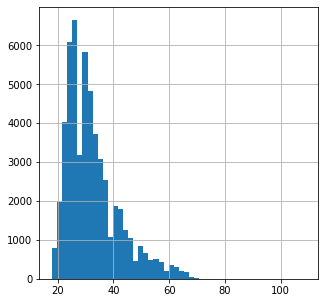

In [12]:
df["age"].hist(bins=50, figsize=(5, 5))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7ffae2ea5750>]],
      dtype=object)

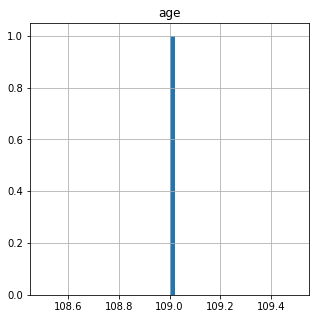

In [13]:
edad=pd.DataFrame(df["age"])
edad.drop(edad[edad["age"].between(1,80)].index).hist(bins=50, figsize=(5, 5))

In [14]:
df=df.drop(df[df["age"].between(60,111)].index)

## Status

In [15]:
print(df["status"].value_counts())

single            49510
seeing someone     1882
available          1688
married             276
unknown               7
Name: status, dtype: int64


In [16]:
df.drop(['status'],axis=1, inplace=True)

## Sex & Orientation

In [17]:
#Juntamos sex y orientation

In [18]:
def heterosBis(row):#castigao
  if row["orientation"] in "straight bisexual":
    return -1
  else:
    return 1000
def lesbiBis(row):#castigao
  if row["orientation"] in "gay bisexual":
    if row["sex"]=="f":
      return -1
  return 1000
def gaysBis(row):#castigao
  if row["orientation"] in "gay bisexual":
    if row["sex"]=="m":
      return -1
  return 1000
df.insert(loc = 20,
          column = 'straight',
          value =df.apply(heterosBis,axis=1))

df.insert(loc = 21,
          column = 'lesbian',
          value =df.apply(lesbiBis,axis=1))
df.insert(loc = 22,
          column = 'gay',
          value =df.apply(gaysBis,axis=1))


In [19]:
df.drop(['sex','orientation'],axis=1, inplace=True)

## Body_type

In [20]:
df["body_type"]=df["body_type"].fillna('average')

In [21]:
def BodyType(x):
        switcher = {
        "athletic": "fit",
        "rather not say": "average",
        "used up":"average",
        "jacked":"fit",
        "overweight":"curvy",
        "full figured":"curvy",
        "skinny":"thin",
        "a little extra": "curvy"
        }
        return switcher.get(x, x)
df["body_type"]=df["body_type"].apply(BodyType)


In [22]:
print(df["body_type"].value_counts())


fit        22546
average    17448
curvy       7474
thin        5895
Name: body_type, dtype: int64


## Diet

In [23]:
print(df["diet"].value_counts())

mostly anything        15923
anything                5837
strictly anything       4929
mostly vegetarian       3213
mostly other             953
strictly vegetarian      830
vegetarian               618
strictly other           429
mostly vegan             315
other                    307
strictly vegan           219
vegan                    128
mostly kosher             84
mostly halal              47
strictly kosher           18
strictly halal            17
halal                     11
kosher                     8
Name: diet, dtype: int64


In [24]:
# el 40.694959% de los datos son nulos

In [25]:
df.drop(['diet'],axis=1, inplace=True)

## Drinks

In [26]:
#no aporta demasiada informacion para clusterizar
df.drop(['drinks'],axis=1, inplace=True)

## Drugs

In [27]:
#no aporta demasiada informacion para clusterizar

In [28]:
df.drop(['drugs'],axis=1, inplace=True)

## Education

In [29]:
df["education"]= df["education"].fillna('high school')

In [30]:
print(df["education"].value_counts())

graduated from college/university    22222
graduated from masters program        8195
working on college/university         5470
high school                           3889
working on masters program            1572
graduated from two-year college       1452
graduated from high school            1377
graduated from ph.d program           1137
working on two-year college           1042
graduated from law school             1010
dropped out of college/university      943
working on ph.d program                897
college/university                     693
graduated from space camp              626
dropped out of space camp              505
working on space camp                  432
graduated from med school              423
working on law school                  241
two-year college                       201
working on med school                  198
dropped out of two-year college        179
dropped out of masters program         130
dropped out of ph.d program            117
masters pro

In [31]:
def eliminarEdu(x):
    if "med" in x:
      return "college/university"
    elif "law" in x:
      return "college/university"
    elif "space camp" in x: 
      return "college/university"
    elif "two-year" in x:
      return "college/university"
    elif "ph.d" in x:
      return "college/university"
    elif "college/university" in x:
      return "college/university"
    elif "high school" in x:
      return "high school"
    else:
        switcher = {
        "dropped out of masters program": "college/university",
        "working on masters program": "masters program",
        "graduated from masters program":"masters program",

        }
        return switcher.get(x, x)


df["education"]=df["education"].apply(eliminarEdu)

## Ethnicity

In [32]:
#no aporta demasiada informacion para clusterizar, speaks lo refleja mejor

In [33]:
pd.DataFrame(df["ethnicity"].value_counts())

,ethnicity
white,29969
asian,5595
hispanic / latin,2580
black,1865
other,1525
...,...
"asian, middle eastern, native american, pacific islander, white, other",1
"indian, hispanic / latin, white, other",1
"asian, black, indian, hispanic / latin, other",1
"asian, indian, hispanic / latin, white",1


In [34]:
df.drop('ethnicity', axis=1, inplace=True)

## Height

Tras el estudio de los datos decidimos eliminar aquellos cuya altura era menor de 50 pulgadas(1 metro) ya que son outlayers.

In [35]:
df["height"]= df["height"].fillna(df["height"].mean())

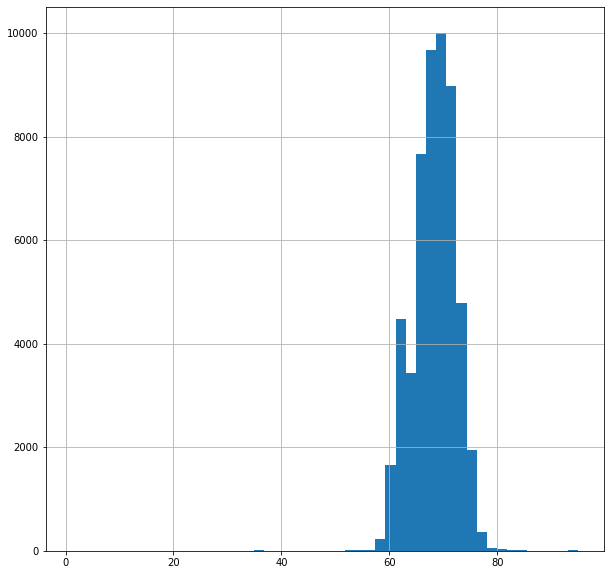

In [36]:
df["height"].hist(bins=50, figsize=(10, 10))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7ffae9ad7f90>]],
      dtype=object)

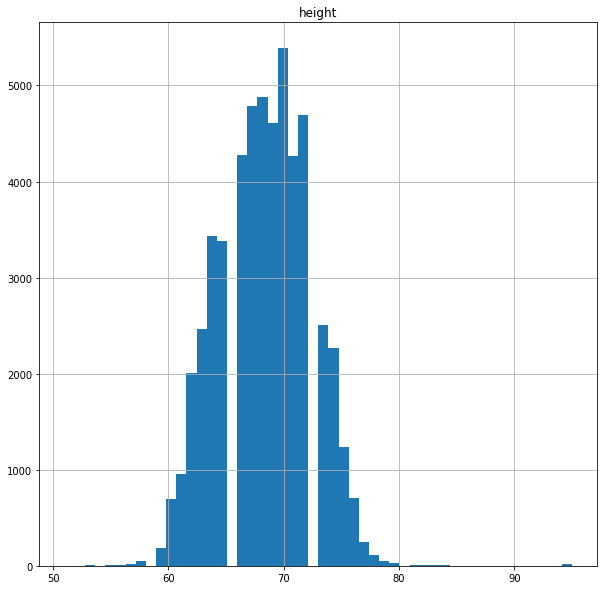

In [37]:
altura=pd.DataFrame(df["height"])
altura.drop(altura[altura["height"].between(0,50)].index).hist(bins=50, figsize=(10, 10))

In [38]:
df=df.drop(df[df["height"].between(0,50)].index)

In [39]:
def cleanOutlay(x):
  if x>79.0:
    return 85.0
  elif x<60.0:
    return 58.0
  else:
    return x
df["height"]=df["height"].apply(cleanOutlay)

## Income

Decidimos eliminar esta columna de nuestro dataset ya que faltan el 80% de los datos (estan a -1)

In [40]:
print(df["income"].value_counts()/59946*100)

-1          70.628566
 20000       4.831015
 100000      2.545624
 80000       1.746572
 30000       1.689854
 40000       1.603109
 50000       1.539719
 60000       1.174390
 70000       1.122677
 150000      0.990892
 1000000     0.815734
 250000      0.220198
 500000      0.071731
Name: income, dtype: float64


In [41]:
df.drop('income', axis=1, inplace=True)

## Job

In [42]:
df["job"]= df["job"].fillna("other")

In [43]:
def job(x):
  switcher = {
        "computer / hardware / software":"science / tech / engineering",
        "banking / financial / real estate":"executive / management",
        "political / government":"executive / management",
        "clerical / administrative": "other",
        "unemployed":"other",
        "rather not say":"other",
        "transportation":"other",
        "retired":"other",
        "military":"other",
        "law / legal services":"executive / management",
        "sales / marketing / biz dev":"executive / management",
        "entertainment / media":"artistic / musical / writer",
        "hospitality / travel":"other",
        "construction / craftsmanship":"other"
        }
  return switcher.get(x, x)
      
df["job"]=df["job"].apply(job)

In [44]:
pd.DataFrame(df["job"].value_counts())

,job
other,16178
executive / management,10444
science / tech / engineering,9084
artistic / musical / writer,6231
student,4724
medicine / health,3425
education / academia,3254


## Last_online

In [45]:
df["last_online"].value_counts()

2012-06-30-23-27    23
2012-06-29-22-56    22
2012-06-30-22-13    22
2012-06-30-22-53    21
2012-06-30-21-51    21
                    ..
2012-01-06-23-07     1
2011-08-29-22-24     1
2012-06-23-17-40     1
2012-03-14-16-32     1
2012-01-12-12-05     1
Name: last_online, Length: 27010, dtype: int64

In [46]:
#max(df["last_online"])= 2012,7,1,8,57

In [47]:
youngest=datetime.datetime(2012,7,1,8,57)
df["last_online"]=df["last_online"].apply(lambda x:  (youngest-datetime.datetime.strptime(x, '%Y-%m-%d-%H-%M')).days)

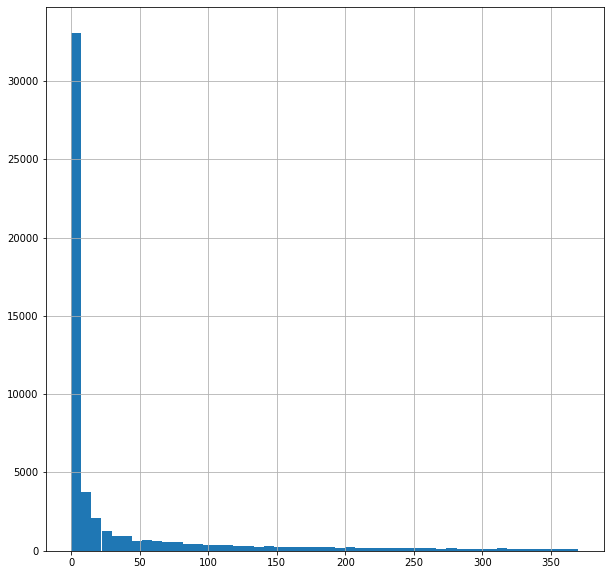

In [48]:
df["last_online"].hist(bins=50, figsize=(10, 10))

In [49]:
def lastOnline(x):
  if x>40:
    return 40
  elif x>7 and x<41:
    return 12
  elif x>0 and x<8:
    return 0
  else:
    return x
df["last_online"]=df["last_online"].apply(lastOnline)

In [50]:
#Eliminamos los datos de la gente que hace que no se conecta mas de 40 días
df=df.drop(df[df["last_online"].between(40,50)].index)

## Location

In [51]:
def location(x):
  switcher = {
        "san francisco, california": "san francisco, california",
        "oakland, california":"oakland, california",
        "berkeley, california":"berkeley, california"
        }
  return switcher.get(x, "other")
      
df["location"]=df["location"].apply(location)

In [52]:
df["location"].value_counts()

san francisco, california    22018
other                        11497
oakland, california           5164
berkeley, california          2925
Name: location, dtype: int64

## Offspring

In [53]:
#Esta columna tiene muchos nulos (60%) por lo que la eliminamos
df.drop(['offspring'],axis=1, inplace=True)

## Pets

In [54]:
df["pets"]= df["pets"].fillna("noPets")

In [55]:
print(df["pets"].value_counts())

noPets                             11632
likes dogs and likes cats          11348
likes dogs                          5666
likes dogs and has cats             3252
has dogs                            2899
has dogs and likes cats             1683
likes dogs and dislikes cats        1526
has dogs and has cats                994
has cats                             963
likes cats                           797
has dogs and dislikes cats           386
dislikes dogs and likes cats         164
dislikes dogs and dislikes cats      126
dislikes cats                         93
dislikes dogs and has cats            47
dislikes dogs                         28
Name: pets, dtype: int64


In [56]:
#juntar a la gente q tiene un animal y q le gustan, perfect match

In [57]:
def outlayersPets(x):
  switcher = {
        "has dogs and has cats": "likes dogs and likes cats",
        "has dogs and likes cats":"likes dogs and likes cats",
        "has dogs": "likes dogs",
        "has cats":"likes dogs and likes cats",
        "likes dogs and dislikes cats":"likes dogs",
        "likes dogs and has cats":"likes dogs and likes cats",
        "has dogs and dislikes cats":"likes dogs",
        "dislikes dogs and likes cats":"likes dogs and likes cats",
        "dislikes dogs and dislikes cats": "noPets",
        "dislikes cats": "noPets",
        "dislikes dogs and has cats":"likes dogs and likes cats",
        "dislikes dogs":"noPets",
        "likes cats":"likes dogs and likes cats"
        }
  return switcher.get(x, x)
df["pets"]=df["pets"].apply(outlayersPets)

## Religion

In [58]:
df["religion"]= df["religion"].fillna("agnosticism")

In [59]:
print(df["religion"].value_counts())

agnosticism                                   14041
agnosticism but not too serious about it       2075
other                                          1972
agnosticism and laughing about it              1953
catholicism but not too serious about it       1721
atheism                                        1669
atheism and laughing about it                  1645
other and laughing about it                    1588
christianity but not too serious about it      1410
christianity                                   1358
judaism but not too serious about it           1182
other but not too serious about it             1090
atheism but not too serious about it           1027
catholicism                                     743
atheism and somewhat serious about it           673
other and somewhat serious about it             611
christianity and somewhat serious about it      588
catholicism and laughing about it               559
judaism and laughing about it                   551
agnosticism 

In [60]:
def outlayersReligion(x):
  if "agnosticism" in x:
    return "agnosticism"
  elif "other" in x:
    return "other"
  elif "catholicism" in x:
    return "catholicism"
  elif "atheism" in x:
    return "atheism"
  elif "christianity" in x:
    return "christianity"
  elif "islam" in x:
    return "other"
  elif "hinduism" in x:
    return "other"
  elif "judaism" in x:
    return "judaism"
  elif "buddhism" in x:
    return "other"
  else:
    return x
df["religion"]=df["religion"].apply(outlayersReligion)

## Sign

In [61]:
df["sign"]= df["sign"].fillna("noSay")

In [62]:
print(df["sign"].value_counts())

noSay                                            5796
scorpio and it&rsquo;s fun to think about        1310
gemini and it&rsquo;s fun to think about         1298
leo and it&rsquo;s fun to think about            1259
taurus and it&rsquo;s fun to think about         1232
libra and it&rsquo;s fun to think about          1219
virgo and it&rsquo;s fun to think about          1183
sagittarius and it&rsquo;s fun to think about    1181
pisces and it&rsquo;s fun to think about         1171
cancer and it&rsquo;s fun to think about         1169
aries and it&rsquo;s fun to think about          1168
leo but it doesn&rsquo;t matter                  1141
virgo but it doesn&rsquo;t matter                1139
cancer but it doesn&rsquo;t matter               1127
aquarius and it&rsquo;s fun to think about       1117
taurus but it doesn&rsquo;t matter               1098
gemini but it doesn&rsquo;t matter               1087
libra but it doesn&rsquo;t matter                1058
sagittarius but it doesn&rsq

In [63]:
def outlayersSign(x):
  if "noSay" in x:
    return "noSay"
  elif "matter" in x:
    return "doesnt matter"
  elif "fun to think about" in x:
    return "its fun"
  else:
    return "cares"
df["sign"]=df["sign"].apply(outlayersSign)

## Smokes

In [64]:
df["smokes"]= df["smokes"].fillna("no")

In [65]:
df["smokes"]=df["smokes"].apply(lambda x:  "sometimes" if x=="when drinking" else x)

In [66]:
print(df["smokes"].value_counts())

no                34666
sometimes          4589
yes                1374
trying to quit      975
Name: smokes, dtype: int64


## Speaks

In [67]:
df["speaks"]= df["speaks"].fillna("english")

In [68]:
pd.DataFrame(df["speaks"].value_counts())

,speaks
english,13672
english (fluently),4716
"english (fluently), spanish (poorly)",1600
"english (fluently), spanish (okay)",1477
"english (fluently), spanish (fluently)",924
...,...
"english (fluently), swedish (fluently), german (poorly), russian (poorly)",1
"english (fluently), french (fluently), portuguese (fluently), italian (fluently), german (fluently)",1
"english (fluently), hebrew (fluently), french (poorly)",1
"english, japanese (okay), chinese (poorly), korean (poorly)",1


In [69]:

s,c,g,f,j,l,r,it,p,tard,sl,v,h=0,0,0,0,0,0,0,0,0,0,0,0,0
for i in df["speaks"]:
    if "spanish" in i:
      s=s+1
    if "chinese" in i:
      c=c+1
    if "french" in i:
      f=f+1
    if "german" in i:
      g=g+1
    if "japanese" in i:
      j=j+1
    if "russian" in i:
      r=r+1
    if "c++" in i:
      tard=tard+1
    if "italian" in i:
      it=it+1
    if "portuguese" in i:
      p=p+1
    if "sign language" in i:
      sl=sl+1
    if "vietnamese" in i:
      v=v+1
    if "hindi" in i:
      h=h+1
    if "latin" in i:
      l=l+1
print(s,c,f,g,j,it,"xd::",tard,r,p,sl,v,h,l)

12211 2650 5791 2297 1611 1616 xd:: 1389 936 798 606 285 558 353


In [70]:
def outlayersSpeaks(i):
    if "spanish" in i:
      return "eng, sp"
    if "chinese" in i:
      return "eng, ch"
    if "french" in i:
      return "eng, fr"
    else:
      return "eng"
df["speaks"]=df["speaks"].apply(outlayersSpeaks)

## Transformer

In [71]:
column_transformer = sklearn.compose.ColumnTransformer(transformers=[
    ("age", sklearn.preprocessing.StandardScaler(), [0]), #int
    ("body_type", sklearn.preprocessing.OrdinalEncoder(), [1]),
    ("education",sklearn.preprocessing.OrdinalEncoder(categories=[['college/university','','','','masters program','','','','','','','','','','','high school']]), [2]),
    ("height",sklearn.preprocessing.StandardScaler(), [3]),#float
    ("job",sklearn.preprocessing.OrdinalEncoder(categories=[['other','','','','','','','','student','','','','','','','','','','','','','','','','','','','','',
                                                             'executive / management','','','','','','science / tech / engineering','','','','','',
                                                             'education / academia','','','','','','','medicine / health','','','','','','','','','','','','','',
                                                             'artistic / musical / writer']]), [4]),
    ("last_online","passthrough", [5]),#int
    ("location",sklearn.preprocessing.OrdinalEncoder(categories=[['san francisco, california','oakland, california','berkeley, california','','','','','','','','','','','','','','','','',
                                                                  'other']]), [6]),#oakland y berkley esta al lado de san francisco
    ("pets",sklearn.preprocessing.OrdinalEncoder(categories=[['likes dogs and likes cats','','','likes dogs','','','','','','','','','noPets']]), [7]),
    ("religion",sklearn.preprocessing.OrdinalEncoder(categories=[['atheism','','','','','','','','','','','','','','','','','','','','agnosticism','','','','','','','','','','','','','','',
                                                             'christianity','','','','','catholicism','','','','','','','','','','','','judaism','','','','','','','','','','','','','','',
                                                             '','','','','','','','','','','','','','','','','','','','','other']]), [8]),#Entendemos que el agnosticismo y el catolicismo estan cerca por la cultura y other muy lejos de los demas por la cultura tb
    ("sign",sklearn.preprocessing.OrdinalEncoder(categories=[['its fun','','noSay','','','','doesnt matter','','','','','','','','','','','','','','','cares']]), [9]), 
    ("smokes", sklearn.preprocessing.OrdinalEncoder(categories=[['no','','','','','','','','','','','','','sometimes','','','','','trying to quit','','','','','','','','','yes']]),[10]),
    ("speaks",sklearn.preprocessing.OrdinalEncoder(categories=[['eng','','','','','eng, sp','','eng, fr','','','','','eng, ch']]),[11]),
    ("straight","passthrough",[12]),
    ("lesbian","passthrough",[13]),
    ("gay","passthrough",[14]),
    ("0","passthrough",[15]),
    ("1","passthrough",[16]),
    ("2","passthrough",[17])


], remainder="drop")

dfTransformed = column_transformer.fit_transform(df)

dfTransformed= pd.DataFrame(dfTransformed, columns=['age', 'body_type', 
                                                   'education', 'height', 'job',
                                                  'last_online', 'location', 'pets', 'religion', 'sign',
                                                  'smokes', 'speaks','straight','lesbian','gay','0','1','2'])
                             
dfTransformed


,age,body_type,education,height,job,last_online,location,pets,religion,sign,smokes,speaks,straight,lesbian,gay,0,1,2
0,-1.176945,1.0,0.0,1.717657,0.0,0.0,19.0,0.0,20.0,21.0,13.0,0.0,-1.0,1000.0,1000.0,4.0,0.0,6.0
1,0.348413,0.0,0.0,0.427982,0.0,0.0,1.0,0.0,20.0,21.0,0.0,5.0,-1.0,1000.0,1000.0,7.0,0.0,8.0
2,0.700418,3.0,4.0,-0.087888,0.0,0.0,0.0,0.0,20.0,6.0,0.0,7.0,-1.0,1000.0,1000.0,1.0,9.0,6.0
3,-1.059610,3.0,0.0,0.685917,8.0,0.0,2.0,0.0,20.0,21.0,0.0,0.0,-1.0,1000.0,1000.0,1.0,2.0,0.0
4,-0.355599,2.0,0.0,-0.603758,62.0,0.0,0.0,0.0,20.0,21.0,0.0,0.0,-1.0,1000.0,1000.0,0.0,1.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41599,3.164458,0.0,0.0,-1.635498,29.0,12.0,1.0,3.0,40.0,0.0,0.0,0.0,-1.0,1000.0,1000.0,3.0,5.0,9.0
41600,-0.942275,2.0,0.0,0.943852,62.0,0.0,0.0,0.0,20.0,6.0,0.0,0.0,-1.0,1000.0,1000.0,0.0,5.0,6.0
41601,1.169759,0.0,4.0,0.685917,0.0,0.0,19.0,12.0,35.0,6.0,0.0,0.0,-1.0,1000.0,1000.0,5.0,9.0,7.0
41602,-0.590269,2.0,0.0,1.201787,48.0,0.0,0.0,0.0,20.0,0.0,18.0,5.0,-1.0,1000.0,1000.0,5.0,0.0,4.0


># **Visualizacion de los datos con reducción de dimensiones**

In [ ]:
def imprimirReducc(X,predict):
  fig = px.scatter_3d(X, x=0, y=1, z=2,
              color=predict)
  fig.show()

### Truncated SVD

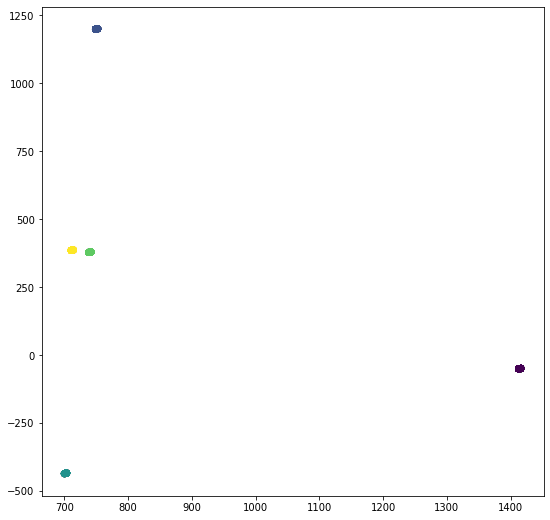

In [ ]:
#Visualizacion de los datos
tsvd = TruncatedSVD(n_components=2) 
X = tsvd.fit_transform(dfTransformed) 
X=pd.DataFrame(X)
# Plotting the clustered scatter plot 
plt.figure(figsize=(9, 9)) 
plt.scatter(X[0], X[1], c = predict) 
plt.show() 

In [ ]:
#Visualizacion de los datos
tsvd = TruncatedSVD(n_components=3) 
X = tsvd.fit_transform(dfReduc) 
imprimirReducc(X,predict)

### PCA

([<matplotlib.patches.Wedge at 0x7f9ca3008690>,
 [Text(0.5814057085329335, 0.9337919479655614, 'age'),
  Text(-1.0566609704759606, 0.30572470209782066, 'body_type'),
  Text(-0.5630967431936369, -0.944945531660275, 'education'),
  Text(0.3972275645252799, -1.025773007044597, 'height'),
  Text(0.8482289437595952, -0.7003625196771182, 'job'),
  Text(0.9500757232401028, -0.5543970780133999, 'last_online'),
  Text(1.018118170115144, -0.4164557499679779, 'location'),
  Text(1.0580814447008917, -0.300771767923244, 'pets'),
  Text(1.0773546251996886, -0.22205182179130767, 'religion'),
  Text(1.0875593990895152, -0.16496834075680447, 'sign'),
  Text(1.0939039226328102, -0.1156469111068298, 'smokes'),
  Text(1.0970446178763136, -0.08057981377872077, 'speaks'),
  Text(1.098552219498023, -0.05641826863674243, 'straight'),
  Text(1.0994505153721714, -0.03476441065035616, 'lesbian'),
  Text(1.099890744699214, -0.015503216601999322, 'gay'),
  Text(1.0999856975815094, -0.00560937751627621, '0'),
  Tex

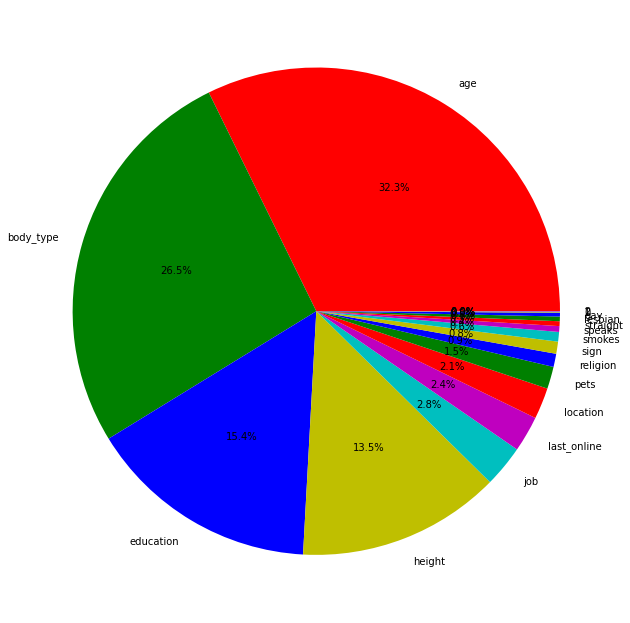

In [ ]:
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(10,10))
fig.tight_layout(pad=4.0)

pca = PCA(n_components=18, random_state=1337).fit(dfTransformed)

axs.pie(pca.explained_variance_ratio_, labels=['age',   'body_type',   'education',      'height',
               'job', 'last_online',    'location',        'pets',
          'religion',        'sign',      'smokes',      'speaks',
          'straight',     'lesbian',         'gay',             "0",
                   "1",             "2"], colors=['r', 'g','b','y','c','m'], autopct='%1.1f%%')

Text(0, 0.5, 'Varianza explicada')

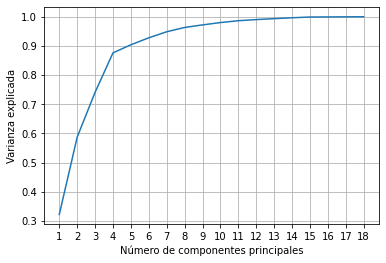

In [ ]:
pca = PCA(n_components=18).fit(pd.DataFrame(dfTransformed))

plt.figure(figsize=(6,4))

xx = np.arange(1, 19, step=1)
yy = np.cumsum(pca.explained_variance_ratio_)

plt.plot(xx, yy)
plt.xticks(xx)
plt.grid(True)


plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza explicada')

In [ ]:
from sklearn.decomposition import PCA

X_low = PCA(n_components=3).fit_transform(dfReduc)

imprimirReducc(X_low,predict)

### ISOMAP

In [ ]:
from sklearn.manifold import Isomap

isomap = Isomap(n_neighbors=10, n_components=3)
X_projected = isomap.fit_transform(dfReduc)
# normalizacion de los datos
x_min, x_max = np.min(X_projected, 0), np.max(X_projected, 0)
X_projected = (X_projected - x_min) / (x_max - x_min)
imprimirReducc(X_projected,predict)

### T-sNE

In [ ]:
 for p in [10,20,30,40,50]:
  tsne = TSNE(n_components=3, perplexity=p)
  X_projected = tsne.fit_transform(dfTransformed)
  y=predict

  # normalizacion de los datos
  x_min, x_max = np.min(X_projected, 0), np.max(X_projected, 0)
  X_projected = (X_projected - x_min) / (x_max - x_min)
  imprimirReducc(X_projected,predict)

In [ ]:
  tsne = TSNE(n_components=3, perplexity=100)
  X_projected = tsne.fit_transform(dfTransformed)
  y=predict

  # normalizacion de los datos
  x_min, x_max = np.min(X_projected, 0), np.max(X_projected, 0)
  X_projected = (X_projected - x_min) / (x_max - x_min)
  imprimirReducc(X_projected,predict)

># **Entrenamiento y Validación de los datos**

In [72]:
#########################################################
#########################################################
#             Funciones auxiliares                      #
#                                                       #
#########################################################
#########################################################

################### Evaluacion  #########################

def evaluacion(beforClust, predict):
  sil=silhouette_score(beforClust.to_numpy(), predict)
  cali=calinski_harabasz_score(beforClust.to_numpy(), predict)
  david=davies_bouldin_score(beforClust.to_numpy(), predict)

  return sil, cali, david
#Dibujar Modelos
def printKmeans(data):
  plt.figure(figsize=(20,10)) 
  plt.plot(data[0], data[1])
  plt.xticks(data[0])
  plt.grid(True)
  plt.show()
def printAglomerative(metric,n):
  equis=[]
  ward=[]
  avg=[]
  comp=[]
  for i in range(0,(n-5)*3,3):
    ward.append(metric[i])
    avg.append(metric[i+1])
    comp.append(metric[i+2])
  rang=range(5,n)
  plt.figure(figsize=(20,10)) 
  plt.plot(rang, ward,'ro',rang,avg,'bo',rang,comp,'go')
  plt.xticks(rang)
  plt.grid(True)
  plt.show()
############ VER CALIDAD CLUSTERS ###################

def calidadClusters(predict,nClusters,data):
  analizar=data
  analizar['y']=predict
  for i in data.columns:
    print("-----------")
    for j in range(nClusters):
      asa=analizar[analizar['y'] == j]
      tot=len(asa)
      print(">>",tot)
      print((asa[i].value_counts().sort_values(ascending=False)/tot*100).head(2))

def resumenCluster(predict,nClusters,data):
  analizar=data
  analizar['y']=predict
  for j in range(nClusters):
    print("-----------")
    asa=analizar[analizar['y'] == j]
    tot=len(asa)
    print(">>",tot)
    for i in data.columns:
      print((asa[i].value_counts().sort_values(ascending=False)/tot*100).head(2))

def unique(list1):
        x = np.array(list1)
        return np.unique(x)

**Nuestro Modelo y su validación**

In [73]:
dfReduc, X_test, y_train, y_test =train_test_split(dfTransformed, dfTransformed["age"],test_size=0.15, random_state=1337)
reduc, X_test, y_train, y_test =train_test_split(df,df["age"], test_size=0.15, random_state=1337)
X_test, y_train, y_test=0,0,0 #reducir la ram

In [74]:
n=8
modelo = AgglomerativeClustering(n_clusters=n, linkage="average")
predict = modelo.fit_predict(dfReduc)
calidadClusters(predict,n,reduc)
evaluacion(dfReduc,predict)

-----------
>> 2411
28    6.719204
26    6.511821
Name: age, dtype: float64
>> 30431
26    6.233775
27    6.158194
Name: age, dtype: float64
>> 317
24    6.940063
23    6.309148
Name: age, dtype: float64
>> 836
25    7.655502
24    7.057416
Name: age, dtype: float64
>> 665
26    7.368421
29    6.766917
Name: age, dtype: float64
>> 134
25    8.208955
27    8.208955
Name: age, dtype: float64
>> 333
23    7.507508
25    7.507508
Name: age, dtype: float64
>> 236
28    6.779661
24    5.932203
Name: age, dtype: float64
-----------
>> 2411
fit        43.425964
average    34.923268
Name: body_type, dtype: float64
>> 30431
fit        44.494101
average    31.898393
Name: body_type, dtype: float64
>> 317
curvy      42.271293
average    27.129338
Name: body_type, dtype: float64
>> 836
curvy      35.885167
average    32.894737
Name: body_type, dtype: float64
>> 665
fit        33.684211
average    33.533835
Name: body_type, dtype: float64
>> 134
fit        40.298507
average    30.597015
Name: body_t

(0.9155711971872249, 766823.6861383882, 0.6719817272259498)

In [75]:
calidadClusters(predict,n,reduc)

-----------
>> 2411
28    6.719204
26    6.511821
Name: age, dtype: float64
>> 30431
26    6.233775
27    6.158194
Name: age, dtype: float64
>> 317
24    6.940063
23    6.309148
Name: age, dtype: float64
>> 836
25    7.655502
24    7.057416
Name: age, dtype: float64
>> 665
26    7.368421
29    6.766917
Name: age, dtype: float64
>> 134
25    8.208955
27    8.208955
Name: age, dtype: float64
>> 333
23    7.507508
25    7.507508
Name: age, dtype: float64
>> 236
28    6.779661
24    5.932203
Name: age, dtype: float64
-----------
>> 2411
fit        43.425964
average    34.923268
Name: body_type, dtype: float64
>> 30431
fit        44.494101
average    31.898393
Name: body_type, dtype: float64
>> 317
curvy      42.271293
average    27.129338
Name: body_type, dtype: float64
>> 836
curvy      35.885167
average    32.894737
Name: body_type, dtype: float64
>> 665
fit        33.684211
average    33.533835
Name: body_type, dtype: float64
>> 134
fit        40.298507
average    30.597015
Name: body_t

In [76]:
resumenCluster(predict,n,reduc)

-----------
>> 2411
28    6.719204
26    6.511821
Name: age, dtype: float64
fit        43.425964
average    34.923268
Name: body_type, dtype: float64
college/university    71.671506
masters program       19.037744
Name: education, dtype: float64
70.0    13.770220
69.0    12.774782
Name: height, dtype: float64
other                     26.379096
executive / management    21.236002
Name: job, dtype: float64
0     76.358358
12    23.641642
Name: last_online, dtype: float64
san francisco, california    69.597677
other                        14.475321
Name: location, dtype: float64
likes dogs and likes cats    42.928246
noPets                       29.780174
Name: pets, dtype: float64
agnosticism    45.624222
other          19.245127
Name: religion, dtype: float64
its fun          41.974285
doesnt matter    29.406885
Name: sign, dtype: float64
no           82.538366
sometimes    11.530485
Name: smokes, dtype: float64
eng        52.136043
eng, sp    33.430112
Name: speaks, dtype: float64
100

## Otros modelos y sus ajustes de hiperparámetros.

### k-means

Muy sensible a outlayers y solo realiza separacion lineal

In [ ]:
kmeans = KMeans(n_clusters = 5, random_state=1337)
predict= kmeans.fit_predict(dfTransformed)
evaluacion(dfTransformed,predict)

(0.9499607205917637, 1505852.9532048802, 0.08039395864484078)

In [ ]:
calidadClusters(predict,5,df)

-----------
>> 35780
26    6.263276
27    6.204584
Name: age, dtype: float64
>> 2844
26    6.399437
28    6.329114
Name: age, dtype: float64
>> 1391
24    6.757728
23    6.613947
Name: age, dtype: float64
>> 1040
26    6.538462
24    6.346154
Name: age, dtype: float64
>> 549
25    7.285974
23    6.921676
Name: age, dtype: float64
-----------
>> 35780
fit        44.826719
average    31.662940
Name: body_type, dtype: float64
>> 2844
fit        43.213783
average    34.704641
Name: body_type, dtype: float64
>> 1391
curvy      38.461538
average    30.265996
Name: body_type, dtype: float64
>> 1040
average    35.384615
fit        32.596154
Name: body_type, dtype: float64
>> 549
fit        37.522769
average    36.247723
Name: body_type, dtype: float64
-----------
>> 35780
college/university    71.425377
masters program       19.740078
Name: education, dtype: float64
>> 2844
college/university    72.222222
masters program       18.530239
Name: education, dtype: float64
>> 1391
college/universit

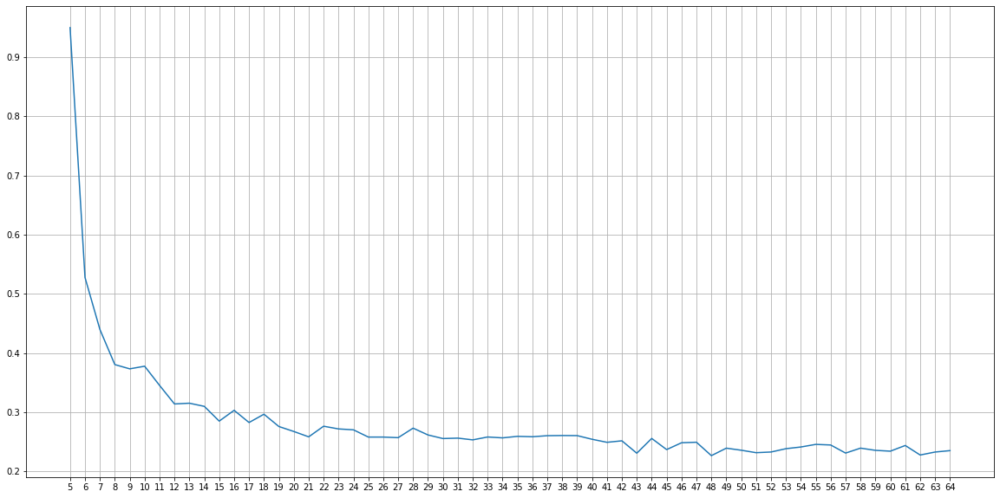

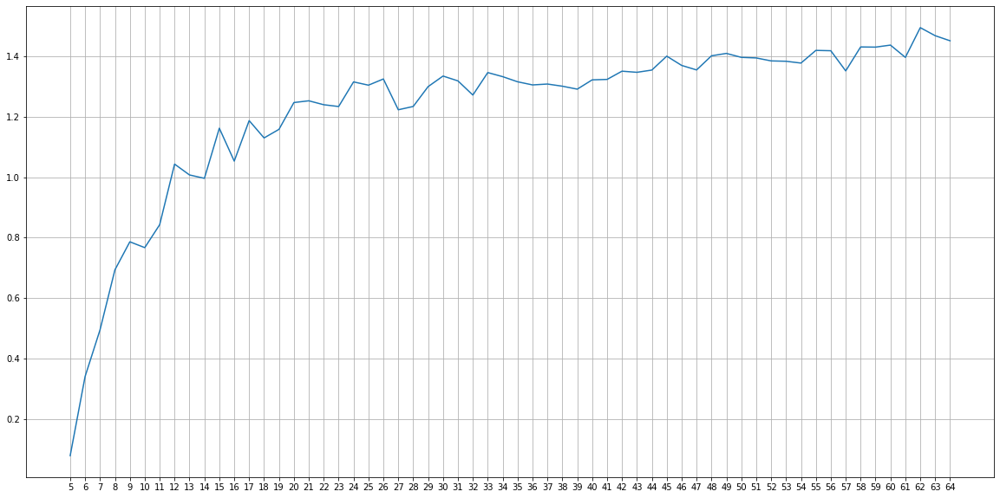

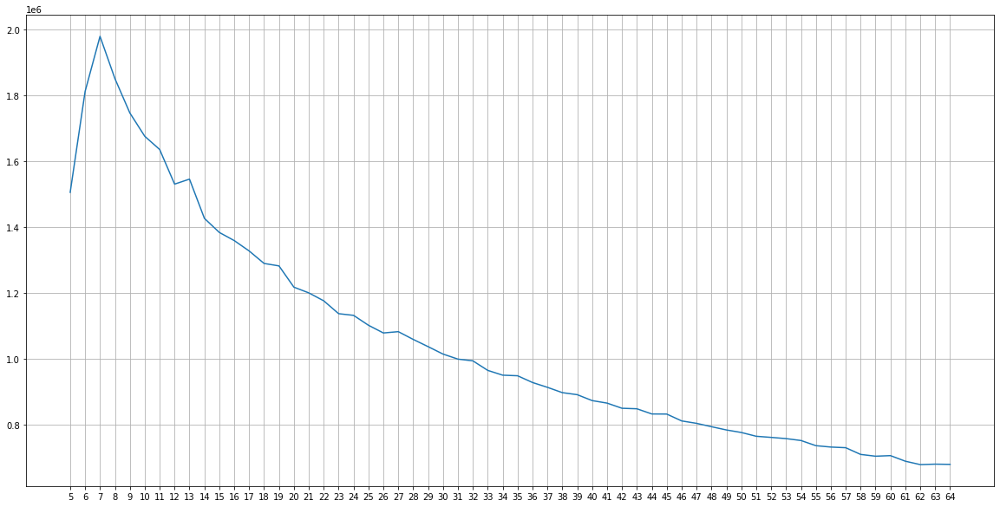

In [ ]:
sil=[]
cali=[]
david=[]
for i in range(5,65):
  kmeans = KMeans(n_clusters = i, random_state=1337)
  predict= kmeans.fit_predict(dfTransformed)

  s,c,d=evaluacion(dfTransformed,predict)
  sil.append(s)
  cali.append(c)
  david.append(d)
printKmeans([range(5,65),sil])
print()
printKmeans([range(5,65),david])
print()
printKmeans([range(5,65),cali])
print()

In [ ]:
# GRID SEARCH CV
#tiene q ser el nombre real de los parametros 
parametros = {
  'n_clusters': np.arange(5,35,1),
  'algorithm': ("auto", "full", "elkan")
}
rs = RandomizedSearchCV(KMeans(), parametros,scoring=silhouette_score,verbose=1, n_jobs=-1, cv=3)

  # Do the Grid Search
rs.fit(dfTransformed)

pd.DataFrame(rs.cv_results_).sort_values('rank_test_score')

Fitting 3 folds for each of 10 candidates, totalling 30 fits


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_clusters,param_algorithm,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,0.906734,0.035765,0.004515,0.003144,15,full,"{'n_clusters': 15, 'algorithm': 'full'}",NaN,NaN,NaN,NaN,NaN,1
1,0.659993,0.022054,0.000928,0.000035,11,full,"{'n_clusters': 11, 'algorithm': 'full'}",NaN,NaN,NaN,NaN,NaN,2
2,2.105264,0.137935,0.000936,0.000048,29,elkan,"{'n_clusters': 29, 'algorithm': 'elkan'}",NaN,NaN,NaN,NaN,NaN,3
3,0.817041,0.029553,0.000963,0.000050,12,auto,"{'n_clusters': 12, 'algorithm': 'auto'}",NaN,NaN,NaN,NaN,NaN,4
4,1.514601,0.056338,0.003839,0.004129,22,elkan,"{'n_clusters': 22, 'algorithm': 'elkan'}",NaN,NaN,NaN,NaN,NaN,5
5,1.358352,0.054485,0.001060,0.000041,24,full,"{'n_clusters': 24, 'algorithm': 'full'}",NaN,NaN,NaN,NaN,NaN,6
6,0.697774,0.006357,0.000994,0.000115,12,full,"{'n_clusters': 12, 'algorithm': 'full'}",NaN,NaN,NaN,NaN,NaN,7
7,1.129636,0.038625,0.000947,0.000014,17,elkan,"{'n_clusters': 17, 'algorithm': 'elkan'}",NaN,NaN,NaN,NaN,NaN,8
8,0.952259,0.015195,0.003285,0.003251,14,auto,"{'n_clusters': 14, 'algorithm': 'auto'}",NaN,NaN,NaN,NaN,NaN,9
9,2.016962,0.253691,0.002623,0.002510,31,auto,"{'n_clusters': 31, 'algorithm': 'auto'}",NaN,NaN,NaN,NaN,NaN,10


In [ ]:
def KOptimizer(nclustersParam,algorimParam, data=dfTransformed):
    print("N Clusters::", nclustersParam)
    cls= KMeans(n_clusters = nclustersParam,algorithm=algorimParam, random_state=1337)
    predict= kmeans.fit_predict(dfTransformed)
    sil=silhouette_score(data.to_numpy(), predict)
    error=[1-sil] #el error no creo q sea lo mejor, probar a fitearlo entre 0 y 1
    print("Silueta", sil)
    return error
# NEVERGRAD
algorimParam= ng.p.TransitionChoice(["auto", "full", "elkan"])
nclustersParam=ng.p.TransitionChoice(range(5,65))
params=ng.p.Instrumentation(nclustersParam,algorimParam)
optimizer=ng.optimizers.NGOpt(parametrization=params, budget=10000)
best=optimizer.minimize(KOptimizer, batch_mode=False)

N Clusters:: 35
Silueta 0.23520327674189304
N Clusters:: 35
Silueta 0.23520327674189304
N Clusters:: 21
Silueta 0.23520327674189304
N Clusters:: 9
Silueta 0.23520327674189304
N Clusters:: 9
Silueta 0.23520327674189304
N Clusters:: 9
Silueta 0.23520327674189304
N Clusters:: 9
Silueta 0.23520327674189304
N Clusters:: 9
Silueta 0.23520327674189304
N Clusters:: 23
Silueta 0.23520327674189304
N Clusters:: 23
Silueta 0.23520327674189304
N Clusters:: 23
Silueta 0.23520327674189304
N Clusters:: 22
Silueta 0.23520327674189304
N Clusters:: 22
Silueta 0.23520327674189304
N Clusters:: 37
Silueta 0.23520327674189304
N Clusters:: 26
Silueta 0.23520327674189304
N Clusters:: 54
Silueta 0.23520327674189304
N Clusters:: 40
Silueta 0.23520327674189304
N Clusters:: 48
Silueta 0.23520327674189304
N Clusters:: 8
Silueta 0.23520327674189304
N Clusters:: 8
Silueta 0.23520327674189304
N Clusters:: 36
Silueta 0.23520327674189304
N Clusters:: 6
Silueta 0.23520327674189304
N Clusters:: 38
Silueta 0.23520327674189

#### MiniBatchKmeans

In [ ]:
  kmeans = MiniBatchKMeans(n_clusters = 11, random_state=1337)
  predict= kmeans.fit_predict(dfTransformed)

### Clustering Jerárquico Aglomerativo

In [78]:
n=8
modelo = AgglomerativeClustering(n_clusters=n, linkage="average")
predict = modelo.fit_predict(dfReduc)
evaluacion(dfReduc,predict)

(0.9155711971872249, 766823.6861383882, 0.6719817272259498)

In [79]:
calidadClusters(predict,n,reduc)

-----------
>> 2411
28    6.719204
26    6.511821
Name: age, dtype: float64
>> 30431
26    6.233775
27    6.158194
Name: age, dtype: float64
>> 317
24    6.940063
23    6.309148
Name: age, dtype: float64
>> 836
25    7.655502
24    7.057416
Name: age, dtype: float64
>> 665
26    7.368421
29    6.766917
Name: age, dtype: float64
>> 134
25    8.208955
27    8.208955
Name: age, dtype: float64
>> 333
23    7.507508
25    7.507508
Name: age, dtype: float64
>> 236
28    6.779661
24    5.932203
Name: age, dtype: float64
-----------
>> 2411
fit        43.425964
average    34.923268
Name: body_type, dtype: float64
>> 30431
fit        44.494101
average    31.898393
Name: body_type, dtype: float64
>> 317
curvy      42.271293
average    27.129338
Name: body_type, dtype: float64
>> 836
curvy      35.885167
average    32.894737
Name: body_type, dtype: float64
>> 665
fit        33.684211
average    33.533835
Name: body_type, dtype: float64
>> 134
fit        40.298507
average    30.597015
Name: body_t

In [85]:
resumenCluster(predict,n,reduc)

-----------
>> 2411
28    6.719204
26    6.511821
Name: age, dtype: float64
fit        43.425964
average    34.923268
Name: body_type, dtype: float64
college/university    71.671506
masters program       19.037744
Name: education, dtype: float64
70.0    13.770220
69.0    12.774782
Name: height, dtype: float64
other                     26.379096
executive / management    21.236002
Name: job, dtype: float64
0     76.358358
12    23.641642
Name: last_online, dtype: float64
san francisco, california    69.597677
other                        14.475321
Name: location, dtype: float64
likes dogs and likes cats    42.928246
noPets                       29.780174
Name: pets, dtype: float64
agnosticism    45.624222
other          19.245127
Name: religion, dtype: float64
its fun          41.974285
doesnt matter    29.406885
Name: sign, dtype: float64
no           82.538366
sometimes    11.530485
Name: smokes, dtype: float64
eng        52.136043
eng, sp    33.430112
Name: speaks, dtype: float64
100

----- 5 ----- ward -----
----- 5 ----- average -----
----- 5 ----- complete -----
----- 6 ----- ward -----
----- 6 ----- average -----
----- 6 ----- complete -----
----- 7 ----- ward -----
----- 7 ----- average -----
----- 7 ----- complete -----
----- 8 ----- ward -----
----- 8 ----- average -----
----- 8 ----- complete -----
----- 9 ----- ward -----
----- 9 ----- average -----
----- 9 ----- complete -----
----- 10 ----- ward -----
----- 10 ----- average -----
----- 10 ----- complete -----
----- 11 ----- ward -----
----- 11 ----- average -----
----- 11 ----- complete -----
----- 12 ----- ward -----
----- 12 ----- average -----
----- 12 ----- complete -----
----- 13 ----- ward -----
----- 13 ----- average -----
----- 13 ----- complete -----
----- 14 ----- ward -----
----- 14 ----- average -----
----- 14 ----- complete -----
----- 15 ----- ward -----
----- 15 ----- average -----
----- 15 ----- complete -----
----- 16 ----- ward -----
----- 16 ----- average -----
----- 16 ----- complete -

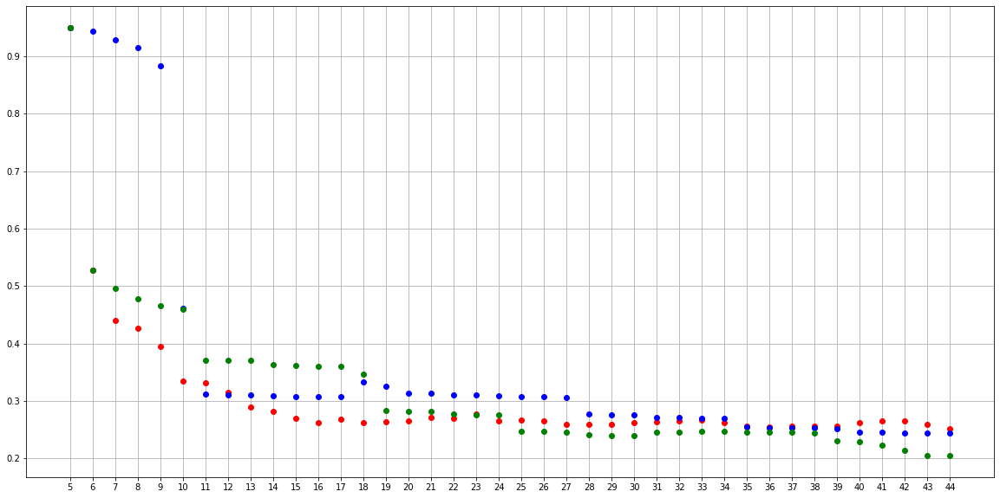

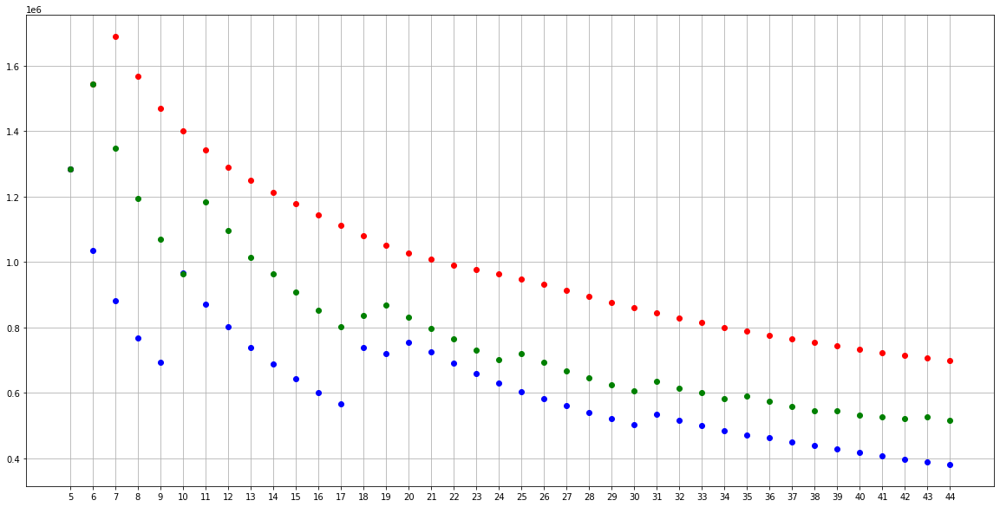

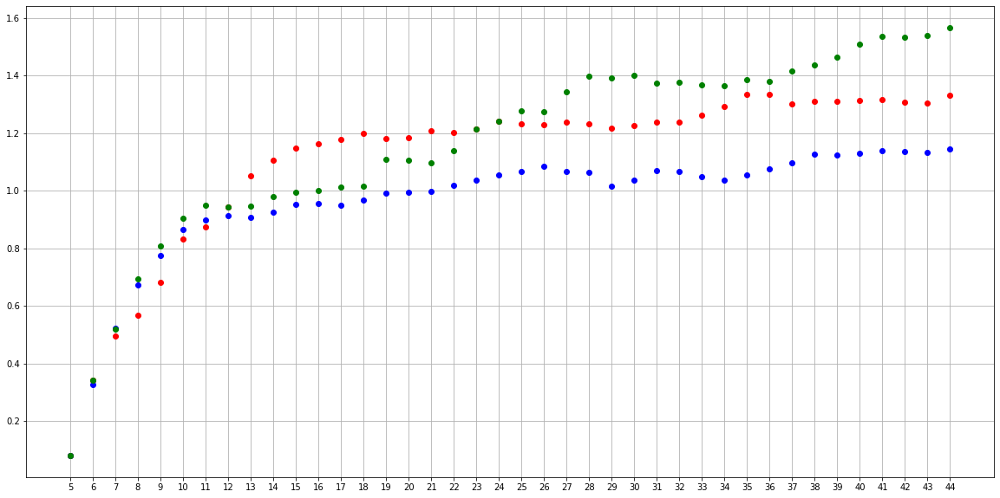

In [ ]:
#Por lo general tiene peores resultados que el Divisivo al no tener en cuenta el conjunto global de datos al empezar

#Funciona bien con Large n_samples and n_clusters
#El parametro linkage se tiene que optimizar; linkage=['ward', 'average', 'complete', 'single']
#single funciona muy bien cuanta menor varianza tenga y mas aislados esten los grupos.

sil=[]
cali=[]
david=[]
n=45
for i in range(5,n):
  for l in ['ward','average', 'complete']:#El single es un mierdon
    print("-----",i,"-----",l,"-----")
    modelo = AgglomerativeClustering(n_clusters=i, linkage=l)
    predict = modelo.fit_predict(dfReduc)

    s,c,d=evaluacion(dfReduc,predict)
    sil.append(s)
    cali.append(c)
    david.append(d)

printAglomerative(sil,n)
print()
printAglomerative(cali,n)
print()
printAglomerative(david,n)
#r b g

In [ ]:
#
#tiene q ser el nombre real de los parametros 
parametros = {
  'n_clusters': np.arange(5,35,1),
  'linkage': ('ward','average', 'complete','single')
}
rs = RandomizedSearchCV(AgglomerativeClustering(), parametros,scoring=silhouette_score,verbose=1, n_jobs=-1, cv=3)

  # Do the Grid Search
rs.fit(dfReduc)

pd.DataFrame(rs.cv_results_).sort_values('rank_test_score')

Fitting 3 folds for each of 10 candidates, totalling 30 fits


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_clusters,param_linkage,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,92.367182,2.354011,0.011815,0.013654,17,average,"{'n_clusters': 17, 'linkage': 'average'}",NaN,NaN,NaN,NaN,NaN,1
1,78.885938,1.446550,0.004826,0.005353,6,ward,"{'n_clusters': 6, 'linkage': 'ward'}",NaN,NaN,NaN,NaN,NaN,2
2,12.563207,0.183154,0.001026,0.000052,30,single,"{'n_clusters': 30, 'linkage': 'single'}",NaN,NaN,NaN,NaN,NaN,3
3,89.540698,3.096615,0.001088,0.000019,7,average,"{'n_clusters': 7, 'linkage': 'average'}",NaN,NaN,NaN,NaN,NaN,4
4,78.702576,0.680486,0.001904,0.001104,19,ward,"{'n_clusters': 19, 'linkage': 'ward'}",NaN,NaN,NaN,NaN,NaN,5
5,12.675311,0.055155,0.001253,0.000452,27,single,"{'n_clusters': 27, 'linkage': 'single'}",NaN,NaN,NaN,NaN,NaN,6
6,74.188899,0.931792,0.001101,0.000007,26,ward,"{'n_clusters': 26, 'linkage': 'ward'}",NaN,NaN,NaN,NaN,NaN,7
7,89.017191,4.506341,0.001882,0.001068,9,average,"{'n_clusters': 9, 'linkage': 'average'}",NaN,NaN,NaN,NaN,NaN,8
8,76.283730,6.310976,0.003189,0.003199,21,complete,"{'n_clusters': 21, 'linkage': 'complete'}",NaN,NaN,NaN,NaN,NaN,9
9,12.310891,0.051017,0.000919,0.000027,23,single,"{'n_clusters': 23, 'linkage': 'single'}",NaN,NaN,NaN,NaN,NaN,10


In [ ]:
def KOptimizer(nclustersParam,linkageParam, data=dfReduc):
    print("N Clusters::", nclustersParam)
    cls = AgglomerativeClustering(n_clusters=nclustersParam, linkage=linkageParam)
    predict = modelo.fit_predict(dfReduc)
    sil=silhouette_score(data.to_numpy(), predict)
    error=[1-sil] 
    print("Silueta", sil)
    return error
# NEVERGRAD
nclustersParam=ng.p.TransitionChoice(range(5,18))
linkageParam=ng.p.TransitionChoice(['ward','average', 'complete'])
params=ng.p.Instrumentation(nclustersParam,linkageParam)
optimizer=ng.optimizers.NGOpt(parametrization=params, budget=10000)
best=optimizer.minimize(KOptimizer, batch_mode=False)

### Clustering Jerárquico Divisivo Ejecutar con R (No hay en python)

In [ ]:
#https://www.datanovia.com/en/lessons/divisive-hierarchical-clustering/

### DBSCAN

In [ ]:
#Cluster labels. Noisy samples are given the label -1.

In [ ]:
#Hiperparametros fit
#Puesto que el hiper-parámetro  ε  se basa en la distancia, para ajustarlo, es interesante conocer la distancía máxima existente:
distancias = kneighbors_graph(dfReduc, 149, mode='distance')
distancias.todense().flatten().max()
#79-50%

77.61326597274591

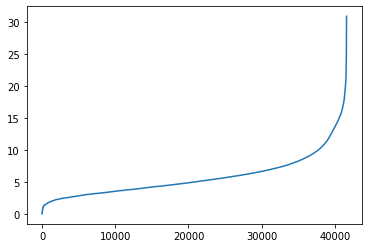

In [ ]:
'''
Hay un proceso para determinar valores óptimos (locales) para los hyper-parámetros del algoritmo:

Se calculan las distancias desde cada punto a los  minPoints−1  más cercanos
Se ordenan las distancias, se plotean y se elige el  ε (EPS) donde la curva es más pronunciada
'''
neigh = NearestNeighbors(n_neighbors=75)
nbrs = neigh.fit(dfReduc)
distances, indices = nbrs.kneighbors(dfTransformed)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.xticks
plt.plot(distances)


In [ ]:
#ajustar min_samples
dbs = DBSCAN(eps=200.0, min_samples=50)
predict=dbs.fit_predict(dfTransformed)

evaluacion(dfTransformed,predict)


In [ ]:
nCls=len(unique(predict))
print(nCls)
calidadClusters(predict,nCls,df)

In [ ]:
sil=[]
cali=[]
david=[]
for eps in range(20,100,20):
  for minS in range(2,303,50):
    print(eps,"-",minS)
    modelo = DBSCAN(eps=eps, min_samples=minS)
    predict = modelo.fit_predict(dfTransformed)
    nCls=len(unique(predict))
    if nCls>1:
      s,c,d=evaluacion(dfTransformed,predict)
      print(s,c,d)
      print(nCls)
      sil.append(s)
      cali.append(c)
      david.append(d)

#r b g

20 - 2
0.2424013894009297 216104.54212124308 1.2806571981909596
36
20 - 52
0.20783230315881268 12928.70902592043 1.1830231490512415
23
20 - 102
0.1848448059320352 9038.730157593023 1.1956583793060094
18
20 - 152
0.17362892495411414 8425.9978140268 1.150481159618664
11
20 - 202
0.18981763264902193 8484.80429941935 1.1817037688698038
9
20 - 252
0.18410372519364246 7967.102817955336 1.1788747380118183
9
20 - 302
0.17132659525640553 7004.587279880263 1.1861281668304429
9
40 - 2
0.9499607205917637 1505852.9532048805 0.08039395864484078
5
40 - 52
0.9499607205917637 1505852.9532048805 0.08039395864484078
5
40 - 102
0.9499607205917637 1505852.9532048805 0.08039395864484078
5
40 - 152
0.9424372669154175 1013412.9086506327 1.2244032704901806
7
40 - 202
0.9438729108696585 1107834.87976202 0.44625771142735576
6
40 - 252
0.9424267041926194 836854.1624913539 0.7377108871160115
6
40 - 302
0.9346533674760924 256447.19255668123 1.0282907000840906
6
60 - 2


### OPTICS

In [ ]:
opt = OPTICS(min_samples=20, xi=0.05, min_cluster_size=0.05)
predict=opt.fit_predict(dfTransformed)

evaluacion(dfTransformed,predict)

#creo haber entendido que hay que correr un OPTICS para ajustar parametros de DBSCAN
#https://scikit-learn.org/stable/auto_examples/cluster/plot_optics.html#sphx-glr-auto-examples-cluster-plot-optics-py

In [ ]:
labels2 = cluster_optics_dbscan(reachability = optics_model.reachability_,
                    core_distances = optics_model.core_distances_,
                    ordering = optics_model.ordering_, eps = 2)

In [ ]:
def unique(list1):
        x = np.array(list1)
        return np.unique(x)

for i in [10,20,30,40,50]:
    optics_model = OPTICS(min_samples=i, xi=0.05, min_cluster_size=0.05)
    predict=optics_model.fit_predict(dfTransformed)
    print("----",i,"-----")
    evaluacion(dfTransformed,predict)
    # Producing the labels according to the DBSCAN technique with eps = 0.5
    labels1 = cluster_optics_dbscan(reachability = optics_model.reachability_,
                    core_distances = optics_model.core_distances_,
                    ordering = optics_model.ordering_, eps = 0.5)

    # Producing the labels according to the DBSCAN technique with eps = 2.0
    labels2 = cluster_optics_dbscan(reachability = optics_model.reachability_,
                    core_distances = optics_model.core_distances_,
                    ordering = optics_model.ordering_, eps = 2)

    # Creating a numpy array with numbers at equal spaces till
    # the specified range
    space = np.arange(len(dfTransformed))

    # Storing the reachability distance of each point
    reachability = optics_model.reachability_[optics_model.ordering_]

    # Storing the cluster labels of each point
    labels = optics_model.labels_[optics_model.ordering_]

    l=unique(labels)
    l1=unique(labels1)
    l2=unique(labels2)
    if len(l)>1:
      print("----labels-----")
      evaluacion(dfTransformed,labels)
    if len(l1)>1:
      print("----labels1-----")
      evaluacion(dfTransformed,labels1)
    if len(l2)>1:
      print("----labels2-----")
      evaluacion(dfTransformed,labels2)
    #creo haber entendido que hay que correr un OPTICS para ajustar parametros de DBSCAN
    #https://scikit-learn.org/stable/auto_examples/cluster/plot_optics.html#sphx-glr-auto-examples-cluster-plot-optics-py

In [ ]:
#tiene q ser el nombre real de los parametros 
parametros = {
  'min_samples': np.arange(10,51,10),
}
rs = RandomizedSearchCV(OPTICS(), parametros,scoring=silhouette_score,verbose=1, n_jobs=-1, cv=3)

  # Do the Grid Search
rs.fit(dfReduc)

pd.DataFrame(rs.cv_results_).sort_values('rank_test_score')

Fitting 3 folds for each of 5 candidates, totalling 15 fits


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_samples,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,823.938246,132.730299,0.004971,0.003201,10,{'min_samples': 10},NaN,NaN,NaN,NaN,NaN,1
1,954.199336,238.370278,0.002421,0.001587,20,{'min_samples': 20},NaN,NaN,NaN,NaN,NaN,2
2,987.811878,454.463503,0.001354,0.000081,30,{'min_samples': 30},NaN,NaN,NaN,NaN,NaN,3
3,1208.990095,301.276235,0.001470,0.000064,40,{'min_samples': 40},NaN,NaN,NaN,NaN,NaN,4
4,680.434782,175.041755,0.001433,0.000184,50,{'min_samples': 50},NaN,NaN,NaN,NaN,NaN,5


### Spectral CLustering

In [ ]:
dfReduc, X_test, y_train, y_test =train_test_split(dfTransformed, dfTransformed["age"],test_size=0.55, random_state=1337)
reduc, X_test, y_train, y_test =train_test_split(df,df["age"], test_size=0.55, random_state=1337)
X_test, y_train, y_test=0,0,0 #reducir la ram

In [ ]:
sil=[]
cali=[]
david=[]
n=20
for i in range(5,n):
    print("-----",i,"-----")
    spectral = SpectralClustering(n_clusters=i, random_state=1337, affinity='laplacian')
    predict = spectral.fit_predict(dfReduc)

    s,c,d=evaluacion(dfReduc,predict)

    sil.append(s)
    cali.append(c)
    david.append(d)

printSC(sil,n)
print()
printSC(cali,n)
print()
printSC(david,n)

In [ ]:
#funcionará pocho, pocos clusters&datos

spectral = SpectralClustering(n_clusters=10, random_state=1337, affinity='laplacian')
predict = spectral.fit_predict(dfReduc)

evaluacion(dfReduc,predict)


In [ ]:
#tiene q ser el nombre real de los parametros 
parametros = {
  'n_clusters': np.arange(5,35,3),
  'affinity': ("nearest_neighbors","rbf", "laplacian")
}
rs = RandomizedSearchCV(SpectralClustering(), parametros,scoring=silhouette_score,verbose=1, n_jobs=-1, cv=3)

  # Do the Grid Search
rs.fit(dfReduc)

pd.DataFrame(rs.cvresults).sort_values('rank_test_score')

> # **Conclusiones**

Tras el analisis de todos los modelos llegamos a varias conclusiones:

En primer lugar, no podemos tomarnos las distintas medidas de evaluacion de nuestros modelos al pie de la letra puesto que claramente cuantos menos clusters mejores serán ya que será más fácil clasificar. Es por esto que tenemos que encontrar una balanceo entre los clusters y las distintas metricas.

Gracias a las distintas gráficas, decidimos quedarnos con el clustering generado por Agglomerative con 8 clusters y un linkage de "average", ya que es el punto en el que mas distinciones hace a nivel de nuestras features sin que decaigan mucho sus métricas.

En segundo lugar, nuestra clusterizacion presenta las siguientes agrupaciones, salvo en algunas columnas en concreto que hemos considerado muy relevantes (orientacion sexual y genero), por desgracia realiza agrupaciones poco especificas, recogiendo varias caracteristicas de una misma columna:


> En el primer cluster, agrupa a una mayoria de hombres homosexuales (straight=1000=no && gay=-1=yes) de 28-26 años, que se encuentran en un estado "fit", que han cursado o estan cursando estudios universitarios, con una altura de 70 pulgadas, se dedican a trabajar en "other", caracteristica que agrupa trabajos poco comunes o sin declarar por los usuarios de la aplicación y agrupo a gente que trabaja en "executive / management".Se conectan habitualmente a la aplicación y viven en San Francisco, California. En su mayoria les gustan los gatos y perros aunque existe una cantidad de personas que no muestran cercania respecto a los animales (noPets), son agnosticos y piensan que los signos del zodiaco son divertidos. Respecto a los campos del essay, es gente a la que le gusta la vida, la familia, los amigos y el trabajo

>En el segundo cluster, la diferencia notable es que agrupa a tanto mujeres como a hombres heterosexuales, los cuales comparten mayoritariamente los atributos mencionados en el primer cluster, diferenciandose en la cantidad de personas que pertenecen a cada categoría.

>En el tercer cluster, la agrupacion que realiza que lamentablemente es erronea, es juntar a hombres y mujeres heterosexuales con las mujeres homosexuales, esto es debido a la existencia de mujeres bisexuales, presentes en ambos campos y que confunden a nuestro algoritmo. Por otra parte destaca el descenso en la edad a 24 años, tipo de cuerpo "curvy", una altura de entorno a 65 pulgadas, un sector laboral de artistas a los que les gustan mucho los animales ( likes dogs and cats y likes dogs son mayoritarios) y creen en religiones minoritarias como el hinduismo, budismo... En el campo de texto destacan los temas relacionados con el disfrute del conocimiento, la gente y la musica.

>En el cuarto cluster, las similitudes con el tercero son enormes. Destacan diferencias como la aparicion de gente que no les gusta mucho las mascotas (no pets), la mayoria de presencia de agnosticos y ateos.

>En el quinto cluster, agrupa unicamente a mujeres homosexuales, de edades entre los 26 y 29 años, con cuerpos normativos. Su altura esta entorno a las 65 pulgadas y les gustan mucho los animales. Respecto al campo de texto, les gusta mucho la musica, la comida y son gente extrovertida (destaca mucho la familia amigos y el trabajo)

>En el sexto cluster, la diferencia notable es que agrupa a hombres bisexuales, gays y heteros entre sí y con mujeres heteros de 25 años, las cuales comparten mayoritariamente las características del primer cluster excepto que su religión entra en la categoría "other", y que sus temas de conversación se centran en el conocimiento y los debates 

>En el séptimo cluster, la diferencia notable es que agrupa a hombres bisexuales gays y heteros entre sí y con mujeres heteros de 23 años, los cuales comparten mayoritariamente las características del primer cluster excepto que su cuerpo entra en la categoría "average", no les importa su signo zodiacal y que sus temas de conversación se centran en la música y el conocimiento y los debates. 

>En el último cluster, la diferencia notable es que agrupa a mujeres lesbianas, las cuales comparten mayoritariamente las características del primer cluster excepto que su cuerpo entra en la categoría "average", su altura es de 65 pulgadas,  su religión  en la categoría "other", y que sus temas de conversación se centran también en el entretenimiento (música, películas, etc) y que les gusta hacer cosas nuevas con amigos.

In [86]:
resumenCluster(predict,n,reduc)

-----------
>> 2411
28    6.719204
26    6.511821
Name: age, dtype: float64
fit        43.425964
average    34.923268
Name: body_type, dtype: float64
college/university    71.671506
masters program       19.037744
Name: education, dtype: float64
70.0    13.770220
69.0    12.774782
Name: height, dtype: float64
other                     26.379096
executive / management    21.236002
Name: job, dtype: float64
0     76.358358
12    23.641642
Name: last_online, dtype: float64
san francisco, california    69.597677
other                        14.475321
Name: location, dtype: float64
likes dogs and likes cats    42.928246
noPets                       29.780174
Name: pets, dtype: float64
agnosticism    45.624222
other          19.245127
Name: religion, dtype: float64
its fun          41.974285
doesnt matter    29.406885
Name: sign, dtype: float64
no           82.538366
sometimes    11.530485
Name: smokes, dtype: float64
eng        52.136043
eng, sp    33.430112
Name: speaks, dtype: float64
100

> # **Transformaciones descartadas**

In [ ]:
df["status"]=df["status"].apply(lambda x: "single" if x=="unknown" else x) 
df["status"]=df["status"].apply(lambda x: "available" if x=="married" else x) 
df["status"]=df["status"].apply(lambda x: "single" if x=="available" else x) 

In [ ]:
topics=8
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=topics, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto')

In [ ]:
j=0
for i in range(len(essays)):
  if essays.at[i,0]=="Empty":
    j=j+1
j#54458 + 5488=59946 (total, works well)

In [ ]:
def cleanLocation(x):
  control=False
  s=""
  for letra in x:
    if control:
      s=s+letra
    if letra==",":
      control=True
  return s
def defoutlayersLocation2(x):
  if "california" not in x:
    return "other"
  else:
    return x
df["location"]=df["location"].apply(defoutlayersLocation2)

In [ ]:
df["drinks"]=df["drinks"].fillna('socially')
df["drinks"]=df["drinks"].apply(lambda x: "often" if x=="very often" else x) 
df["drinks"]=df["drinks"].apply(lambda x: "often" if x=="desperately" else x)
df["drinks"]=df["drinks"].apply(lambda x: "rarely" if x=="not at all" else x) 
print(df["drinks"].value_counts())


In [ ]:
  elif x =="dropped out of ph.d program":
    return "graduated from masters program"
  elif x =="working on ph.d program": 
    return "ph.d program"

  elif x =="dropped out of masters program":
    return "graduated from college/university"
  elif x =="working on masters program":
    return "masters program"


  elif x =="working on high school":
    return "high school"
  elif x == "dropped out of high school":
    return "high school"

  elif x =="dropped out of two-year college" or "working on two-year college": 
    return "two-year college"

  elif x =="dropped out of college/university" or "working on college/university": #No estoy seguro del dropped, ya que meterlo en highschool seria raro. 995.
    return "college/university"

  else:
    return x

In [ ]:
print("Normal               ", essays[0][0])
print("Get rid of puntuation",essay0Preprocessed[0])
print("Get rid of stopWords ",essay0NoStopwords[0])
print("Hacer algo Trigrams   ",essay0Trigrams[0])
print("Simplificar vb, nn   ",essay0Lemmatized[0])


Normal                about me:  i would love to think that i was some some kind of intellectual: either the dumbest smart guy, or the smartest dumb guy. can't say i can tell the difference. i love to talk about ideas and concepts. i forge odd metaphors instead of reciting cliches. like the simularities between a friend of mine's house and an underwater salt mine. my favorite word is salt by the way (weird choice i know). to me most things in life are better as metaphors. i seek to make myself a little better everyday, in some productively lazy way. got tired of tying my shoes. considered hiring a five year old, but would probably have to tie both of our shoes... decided to only wear leather shoes dress shoes.  about you:  you love to have really serious, really deep conversations about really silly stuff. you have to be willing to snap me out of a light hearted rant with a kiss. you don't have to be funny, but you have to be able to make me laugh. you should be able to bend spoons wit

In [ ]:
def percentilesEdad(columna):
  x=df[columna].quantile([0,0.2,0.4,0.6,0.8,1])
  qs=[]
  for i in range(len(x)):
    qs=qs+[x.iloc[i]]
  return qs
percenEdad=percentilesEdad("age")
for i in df.index:
  if df.at[i,"age"]<percenEdad[0]:
    df.at[i,"age"]=0
  elif df.at[i,"age"]>=percenEdad[0]and df.at[i,"age"]<percenEdad[1]:
    df.at[i,"age"]=1
  elif df.at[i,"age"]>=percenEdad[1] and df.at[i,"age"]<percenEdad[2]:
    df.at[i,"age"]=2
  elif df.at[i,"age"]>=percenEdad[2] and df.at[i,"age"]<percenEdad[3]:
    df.at[i,"age"]=3
  elif df.at[i,"age"]>=percenEdad[3]and df.at[i,"age"]<percenEdad[4]:
    df.at[i,"age"]=4
  else:
    df.at[i,"age"]=5

In [ ]:
def outlayersSign(x):
  if "gemini" in x:
    return "gemini"
  elif "scorpio" in x:
    return "scorpio"
  elif "leo" in x:
    return "leo"
  elif "libra" in x:
    return "libra"
  elif "taurus" in x:
    return "taurus"
  elif "cancer" in x:
    return "cancer"
  elif "pisces" in x:
    return "pisces"
  elif "sagittarius" in x:
    return "sagittarius"
  elif "virgo" in x:
    return "virgo"
  elif "aries" in x:  #10
    return "aries"
  elif "capricorn" in x:
    return "capricorn"
  elif "aquarius" in x:
    return "aquarius"
  else:
    return x
df["sign"]=df["sign"].apply(outlayersSign)

In [ ]:
df["job"]=df["job"].apply(lambda x: "other" if x=="military" else x) 
df["job"]=df["job"].apply(lambda x: "other" if x=="retired" else x) 
df["job"]=df["job"].apply(lambda x: "other" if x=="transportation" else x) 
df["job"]=df["job"].apply(lambda x: "other" if x=="rather not say" else x)
df["job"]=df["job"].apply(lambda x: "other" if x=="unemployed" else x) 


df["job"]=df["job"].apply(lambda x: "political / government" if x=="clerical / administrative" else x) #revisar

In [ ]:
column_transformer = sklearn.compose.ColumnTransformer(transformers=[
    ("age", sklearn.preprocessing.StandardScaler(), [0]), #int
    ("status",sklearn.preprocessing.OrdinalEncoder(), [1]),                                                       
    ("sex", sklearn.preprocessing.OneHotEncoder(drop="first"), [2]),# creo que funcionara mejor como dummy variable por su importancia
    ("orientation",sklearn.preprocessing.OrdinalEncoder(),[3]),# esta tambien se puede plantear como dummy
    ("body_type", sklearn.preprocessing.OrdinalEncoder(), [4]),
    ("diet", sklearn.preprocessing.OrdinalEncoder(), [5]),
    ("drinks",sklearn.preprocessing.OrdinalEncoder(), [6]),
    ("drugs",sklearn.preprocessing.OrdinalEncoder(), [7]),
    ("education",sklearn.preprocessing.OrdinalEncoder(), [8]),
    ("ethnicity",sklearn.preprocessing.OrdinalEncoder(), [9]),
    ("height",sklearn.preprocessing.StandardScaler(), [10]),#float
    ("job",sklearn.preprocessing.OrdinalEncoder(), [11]),
    ("last_online","passthrough", [12]),#int
    ("location",sklearn.preprocessing.OrdinalEncoder(), [13]),
    ("offspring",sklearn.preprocessing.OrdinalEncoder(), [14]),
    ("pets",sklearn.preprocessing.OrdinalEncoder(), [15]),
    ("religion",sklearn.preprocessing.OrdinalEncoder(), [16]),
    ("sign",sklearn.preprocessing.OrdinalEncoder(), [17]), 
    ("smokes", sklearn.preprocessing.OrdinalEncoder(),[18]),
    ("speaks",sklearn.preprocessing.OrdinalEncoder(),[19])



], remainder="passthrough")
"""    ,
    ("essay0", sklearn.preprocessing.OrdinalEncoder(),[21]),
    ("essay1",sklearn.preprocessing.OrdinalEncoder(),[22]), 
    ("essay2", sklearn.preprocessing.OrdinalEncoder(),[23]),
    ("essay3",sklearn.preprocessing.OrdinalEncoder(),[24]), 
    ("essay4", sklearn.preprocessing.OrdinalEncoder(),[25]),
    ("essay5", sklearn.preprocessing.OrdinalEncoder(),[26]),
    ("essay6", sklearn.preprocessing.OrdinalEncoder(),[27]),
    ("essay7", sklearn.preprocessing.OrdinalEncoder(),[28]),
    ("essay8", sklearn.preprocessing.OrdinalEncoder(),[29]),
    ("essay9", sklearn.preprocessing.OrdinalEncoder(),[30])

    , 'essay0', 'essay1', 'essay2', 'essay3', 'essay4',
                                                  'essay5', 'essay6', 'essay7', 'essay8', 'essay9'
"""
dfTransformed = column_transformer.fit_transform(df)

dfTransformed= pd.DataFrame(dfTransformed, columns=['age', 'status', 'sex', 'orientation', 'body_type', 'diet', 'drinks',
                                                  'drugs', 'education', 'ethnicity', 'height', 'job',
                                                  'last_online', 'location', 'offspring', 'pets', 'religion', 'sign',
                                                  'smokes', 'speaks','0','1','2','3','4','5','6','7','8','9','10','11','12','13','14'])
dfTransformed


In [ ]:
df["offspring"]= df["offspring"].fillna("doesn't have kids")
def outlayersOffspring(x):
  switcher = {
        "has kids, but doesn't want more": "has kids",
        "has a kid, but doesn't want more": "has kids",
        "has a kid, and might want more":"has kids",
        "has a kid, and wants more":"has kids",
        "has kids, and wants more":"has kids",
        "has kids, and might want more": "has kids",
        "has kids, and might want more": "has kids",
        "has a kid": "has kids",

        "wants kids": "doesn't have kids, but wants them",
        "might want kids": "doesn't have kids, but wants them",
        
        "doesn't have kids, and doesn't want any":"doesn't want kids",# lo importante es q no quiere hijos
        "doesn't have kids, but might want them":"doesn't have kids, but wants them",
        }
  return switcher.get(x, x)
df["offspring"]=df["offspring"].apply(outlayersOffspring)
print(df["offspring"].value_counts())

In [ ]:
df["drugs"]=df["drugs"].fillna('never')
df["drugs"]=df["drugs"].apply(lambda x: "sometimes" if x=="often" else x) 
print(df["drugs"].value_counts())

In [ ]:
df["diet"]=df["diet"].fillna('anything')
def eliminarDiet(x):
  if x in "strictly other, mostly other, kosher, mostly kosher, strictly kosher, halal, mostly halal, strictly halal":
    return "other"
  elif x in "mostly anything, strictly anything":
    return "anything"
  elif x in "mostly vegetarian, strictly vegetarian": #Revisar si va bien o mal para el modelo
    return "vegetarian"
  elif x in "mostly vegan, strictly vegan": #Revisar si va bien o mal para el modelo
    return "vegan"
  else:
    return x

df["diet"]=df["diet"].apply(eliminarDiet)
print(df["diet"].value_counts())


In [ ]:
'''
def outlayersSpeaks(i):
    if "spanish" in i:
      return "eng, sp"
    if "chinese" in i:
      return "eng, ch"
    if "french" in i:
      return "eng, fr"
    if "german" in i:
      return "eng, ger"
    if "japanese" in i:
      return "eng, jp"
    if "russian" in i:
      return "eng, rus"
    if "c++" in i:
      return "imbecil"
    else:
      return "eng"

  eng	33123
eng, sp	16312
eng, fr	4439
eng, ch	2768
eng, ger	1312
eng, jp	812
imbecil	596
eng, rus	584

//quitar jp c++ ruso y aleman

for i in df["speaks"]:
    if "german (poorly)" in i:
      s=s+1
devuelve 1500 por lo q a la mierda los alemanes, lo habran puesto en essay
'''

In [ ]:
column_transformer = sklearn.compose.ColumnTransformer(transformers=[
    ("age", sklearn.preprocessing.StandardScaler(), [0]), #int
    ("body_type", sklearn.preprocessing.OrdinalEncoder(), [1]),
    ("education",sklearn.preprocessing.OrdinalEncoder(), [2]),
    ("ethnicity",sklearn.preprocessing.OrdinalEncoder(), [3]),
    ("height",sklearn.preprocessing.StandardScaler(), [4]),#float
    ("job",sklearn.preprocessing.OrdinalEncoder(), [5]),
    ("last_online","passthrough", [6]),#int
    ("location",sklearn.preprocessing.OrdinalEncoder(), [7]),
    ("pets",sklearn.preprocessing.OrdinalEncoder(), [8]),
    ("religion",sklearn.preprocessing.OrdinalEncoder(), [9]),
    ("sign",sklearn.preprocessing.OrdinalEncoder(), [10]), 
    ("smokes", sklearn.preprocessing.OrdinalEncoder(),[11]),
    ("speaks",sklearn.preprocessing.OrdinalEncoder(),[12]),
    ("straight","passthrough",[13]),
    ("lesbian","passthrough",[14]),
    ("gay","passthrough",[15]),
    ("0","passthrough",[16]),
    ("1","passthrough",[17]),
    ("2","passthrough",[18])


], remainder="drop")

dfTransformed = column_transformer.fit_transform(df)

dfTransformed= pd.DataFrame(dfTransformed, columns=['age', 'body_type', 
                                                   'education', 'ethnicity', 'height', 'job',
                                                  'last_online', 'location', 'pets', 'religion', 'sign',
                                                  'smokes', 'speaks','straight','lesbian','gay','0','1','2'])
                              #,'0','1','2','3','4','5','6','7','8','9','10','11','12','13','14'])
dfTransformed


In [ ]:
'''
("straight",sklearn.preprocessing.OrdinalEncoder(categories=[['y','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','',
                                                                  '','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','',
                                                                  'n']]),[12]),
    ("lesbian",sklearn.preprocessing.OrdinalEncoder(categories=[['y','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','',
                                                                  '','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','',
                                                                  'n']]),[13]),
    ("gay",sklearn.preprocessing.OrdinalEncoder(categories=[['y','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','',
                                                                  '','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','','',
                                                                  'n']]),[14]),
                                                                  '''

In [ ]:
df["ethnicity"]= df["ethnicity"].fillna('white')
def outlayersETH(x):
  s=""
  if x[0:5]=="white":
    return "white"
  for letra in x:
    if letra==",":
      return s
    else:
      s=s+letra
  return s
def eth(x):
    if "indian" in x:
      return "other"
    elif "middle eastern" in x:
      return "other"
    elif "pacific islander" in x: 
      return "other"
    elif "native american" in x:
      return "other"
    else:
      return x
      
df["ethnicity"]=df["ethnicity"].apply(outlayersETH)
df["ethnicity"]=df["ethnicity"].apply(eth)